# Music Genre Classifier


---
Dr. Aritan Piplai | Machine Learning | Fall 2023 | CS4361
<br>
<br>
Alan Ochoa | Sergio Velasco | Seth Velasco




# Setup

In [3]:
!pip install librosa
!pip install python_speech_features
!pip install numpy
!pip install scipy
!pip install matplotlib
!pip install IPython
!pip install mir_eval
!pip install sklearn
!pip install pandas
!pip install pyAudioAnalysis
!pip install seaborn
!pip install tensorflow
!pip install keras
!pip install pytorch
!pip install torchaudio
!pip install ffmpeg-python
!pip install ffmpeg-libav
!pip install ffmpeg
!pip install --upgrade librosa
!pip install soundfile
!pip install loader
!pip install loader1
!pip install tqdm

  Using cached sklearn-0.0.post12.tar.gz (2.6 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Using cached pytorch-1.0.2.tar.gz (689 bytes)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for pytorch
  Running setup.py clean for pytorch
Failed to build pytorch
ERROR: Could not build wheels for pyto

Library Imports

In [4]:
import os
import math
import json
import scipy
import random
import librosa
import operator
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.io.wavfile as wav
import IPython.display as ipd
import matplotlib.pyplot as plt

from importlib import reload
from tempfile import TemporaryFile
from python_speech_features import mfcc
from sklearn.preprocessing import normalize
plt=reload(plt)

Kaggle Account Token Upload:

In [165]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle (2).json


{'kaggle (2).json': b'{"username":"aeochoa","key":"45c59091d2ed36f75a2b09d98b47a0a4"}'}

# [GZTan](https://www.kaggle.com/datasets/andradaolteanu/gtzan-dataset-music-genre-classification) [^1]

---

A collection of 10 genres with 100 audio files each, with audio samples with lengths of 30 seconds and 3 seconds (.wav files):

- 22,050 Hz sample rate
- Converted to mono  
- AU file format
- 16-bit audio files

### Retrieving GZTan Dataset:

In [162]:
%%shell
mkdir -p ~/.kaggle
cp kaggle.json ~/.kaggle/
chmod 600 ~/.kaggle/kaggle.json
ls ~/.kaggle

pip install kaggle
pip install python_speech_features
kaggle datasets download -d andradaolteanu/gtzan-dataset-music-genre-classification
unzip gtzan-dataset-music-genre-classification.zip

kaggle.json
gtzan-dataset-music-genre-classification.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  gtzan-dataset-music-genre-classification.zip
replace Data/features_30_sec.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


### Inspecting the Dataset

In [5]:
SAMPLE_RATE = 22050 # hz
DURATION = 30 # 3 | 30 seconds
SAMPLES_PER_TRACK = SAMPLE_RATE * DURATION # 661500
NUM_FFT = 2048
HOP_LENGTH = 512
DATASET_PATH = '/content/Data/genres_original/'

In [205]:
dataset_path = r"../content/Data"
genres=os.listdir(os.path.join(dataset_path,'./genres_original/')) # 10 genres
print(genres)

['country', 'reggae', 'metal', 'jazz', 'pop', 'blues', 'disco', 'hiphop', 'classical', 'rock']


In [206]:
music_data = pd.read_csv('/content/Data/features_30_sec.csv')
music_data['label'].value_counts()
music_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 1000 non-null   object 
 1   length                   1000 non-null   int64  
 2   chroma_stft_mean         1000 non-null   float64
 3   chroma_stft_var          1000 non-null   float64
 4   rms_mean                 1000 non-null   float64
 5   rms_var                  1000 non-null   float64
 6   spectral_centroid_mean   1000 non-null   float64
 7   spectral_centroid_var    1000 non-null   float64
 8   spectral_bandwidth_mean  1000 non-null   float64
 9   spectral_bandwidth_var   1000 non-null   float64
 10  rolloff_mean             1000 non-null   float64
 11  rolloff_var              1000 non-null   float64
 12  zero_crossing_rate_mean  1000 non-null   float64
 13  zero_crossing_rate_var   1000 non-null   float64
 14  harmony_mean             

#### Fournier Transformations


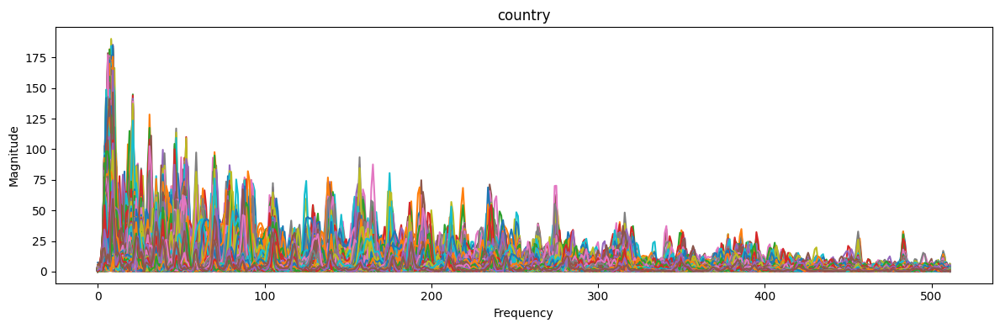

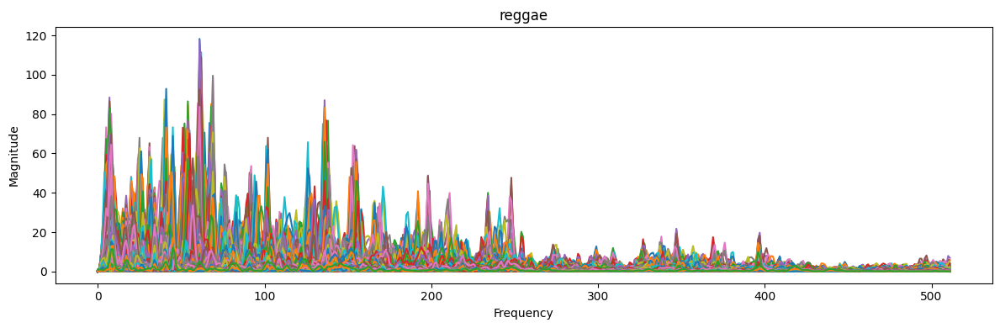

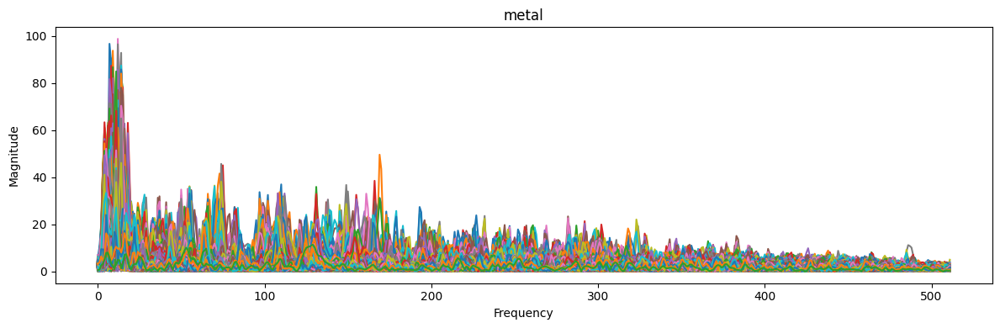

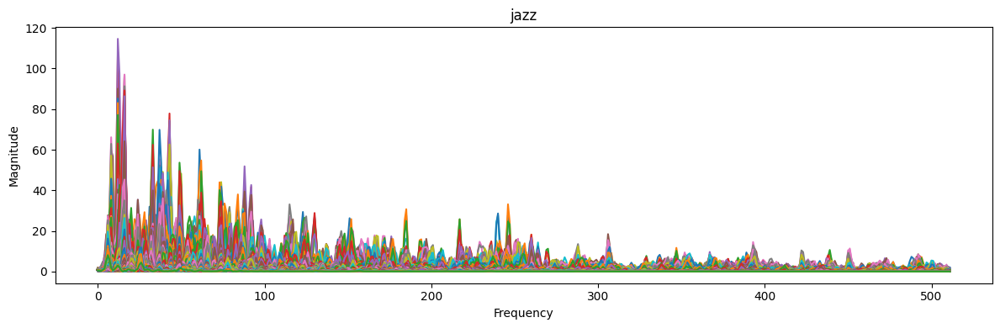

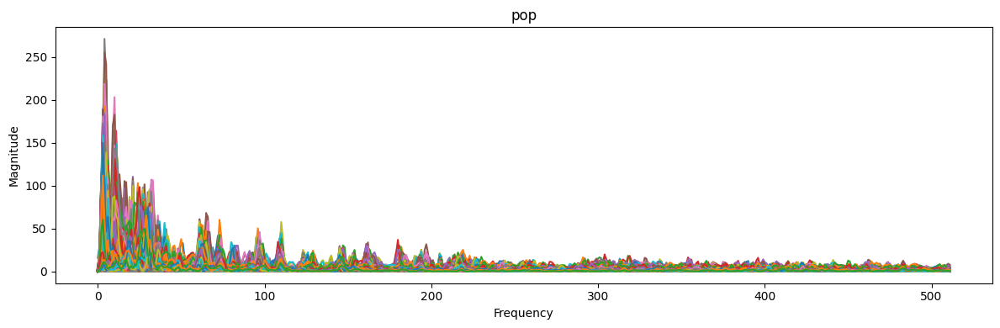

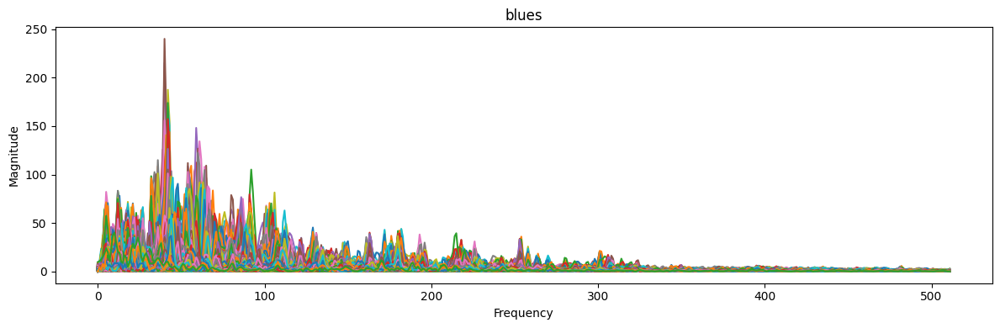

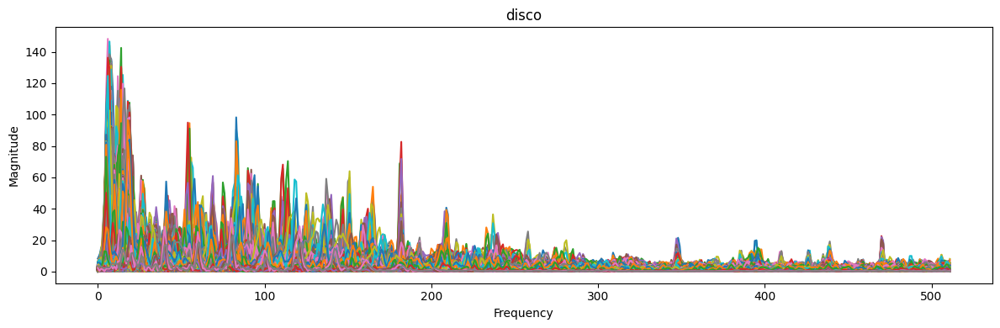

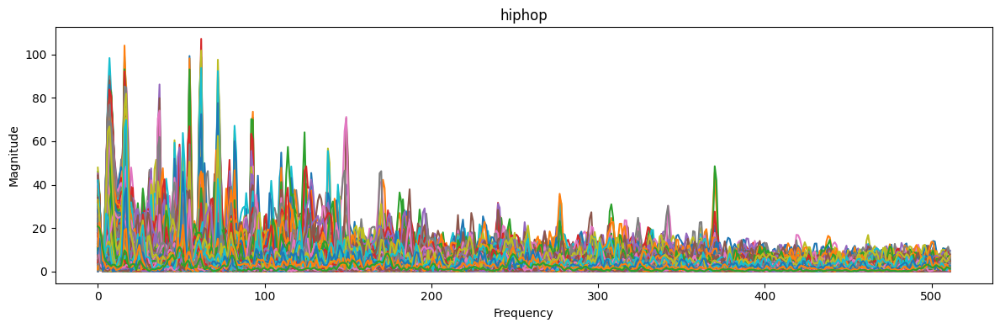

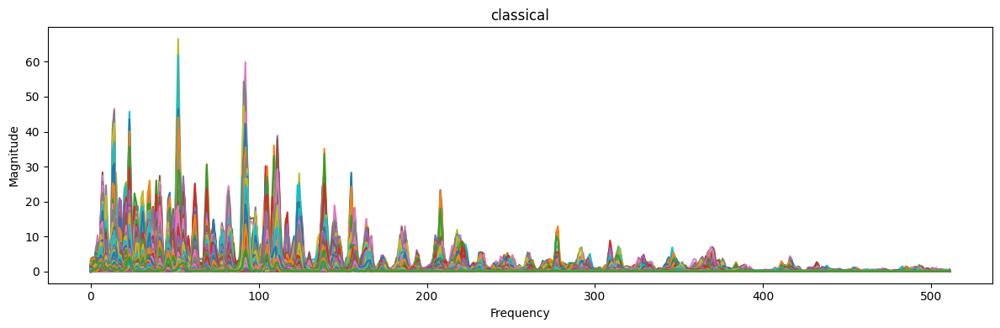

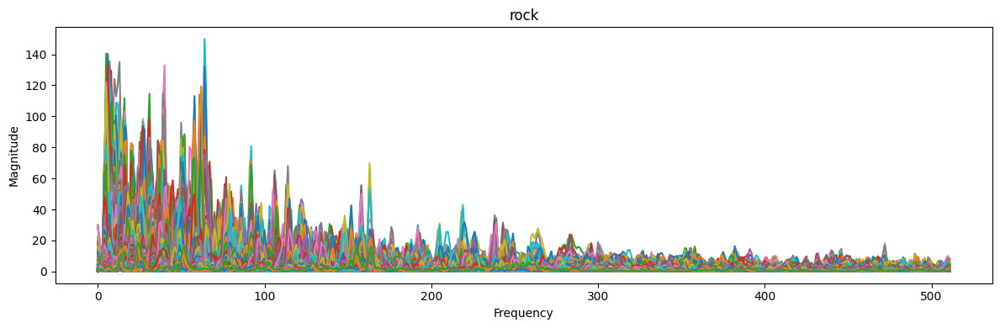

In [208]:
for i in genres:
    audio,sr=librosa.load(os.path.join(dataset_path,'./genres_original',i,f'{i}.00000.wav'))
    audio_ft= np.abs(librosa.stft(audio, n_fft=NUM_FFT, hop_length=HOP_LENGTH, win_length=NUM_FFT))

    plt.figure(figsize=(12,4))

    plt.plot(audio_ft[:512,:]) # human hearing range [20:20000] in hz
    plt.title(f'{i}')
    plt.xlabel("Frequency")
    #plt.xlim(SAMPLES_PER_TRACK)
    plt.ylabel("Magnitude")
    #plt.yscale('symlog')  # Use a symmetric logarithmic scale for the y-axis

    # Autoscale both axes
    plt.autoscale(True)
    plt.tight_layout()  # Adjust layout to prevent overlapping labels
    #plt.legend()
    plt.show()

#### Mean Correlation Between Genres

<ipython-input-210-8132c8f314e2>:5: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(genre_correlations, dtype=np.bool)) # Hide values above matrix's diagnonal


(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5,
        22.5, 23.5, 24.5, 25.5, 26.5, 27.5]),
 [Text(0, 0.5, 'chroma_stft_mean'),
  Text(0, 1.5, 'rms_mean'),
  Text(0, 2.5, 'spectral_centroid_mean'),
  Text(0, 3.5, 'spectral_bandwidth_mean'),
  Text(0, 4.5, 'rolloff_mean'),
  Text(0, 5.5, 'zero_crossing_rate_mean'),
  Text(0, 6.5, 'harmony_mean'),
  Text(0, 7.5, 'perceptr_mean'),
  Text(0, 8.5, 'mfcc1_mean'),
  Text(0, 9.5, 'mfcc2_mean'),
  Text(0, 10.5, 'mfcc3_mean'),
  Text(0, 11.5, 'mfcc4_mean'),
  Text(0, 12.5, 'mfcc5_mean'),
  Text(0, 13.5, 'mfcc6_mean'),
  Text(0, 14.5, 'mfcc7_mean'),
  Text(0, 15.5, 'mfcc8_mean'),
  Text(0, 16.5, 'mfcc9_mean'),
  Text(0, 17.5, 'mfcc10_mean'),
  Text(0, 18.5, 'mfcc11_mean'),
  Text(0, 19.5, 'mfcc12_mean'),
  Text(0, 20.5, 'mfcc13_mean'),
  Text(0, 21.5, 'mfcc14_mean'),
  Text(0, 22.5, 'mfcc15_mean'),
  Text(0, 23.5, 'mfcc16_mean'),
  Text(0, 24.5, 

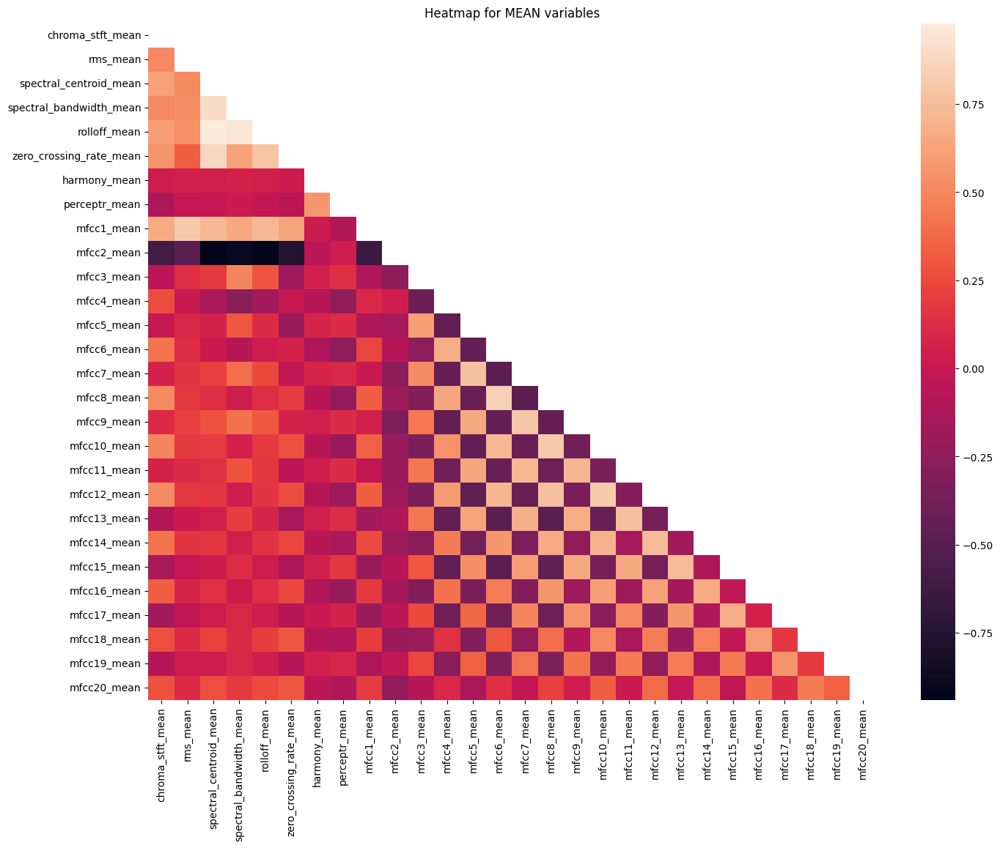

In [210]:
# Computing a Correlation Matrix
mean_data_columns = [col for col in music_data.columns if 'mean' in col]
genre_correlations = music_data[mean_data_cols].corr()

mask = np.triu(np.ones_like(genre_correlations, dtype=np.bool)) # Hide values above matrix's diagnonal

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(16, 12));
sns.heatmap(genre_correlations, mask=mask)

plt.title('Heatmap for MEAN variables')
plt.xticks()
plt.yticks()

#### Genre Distributions

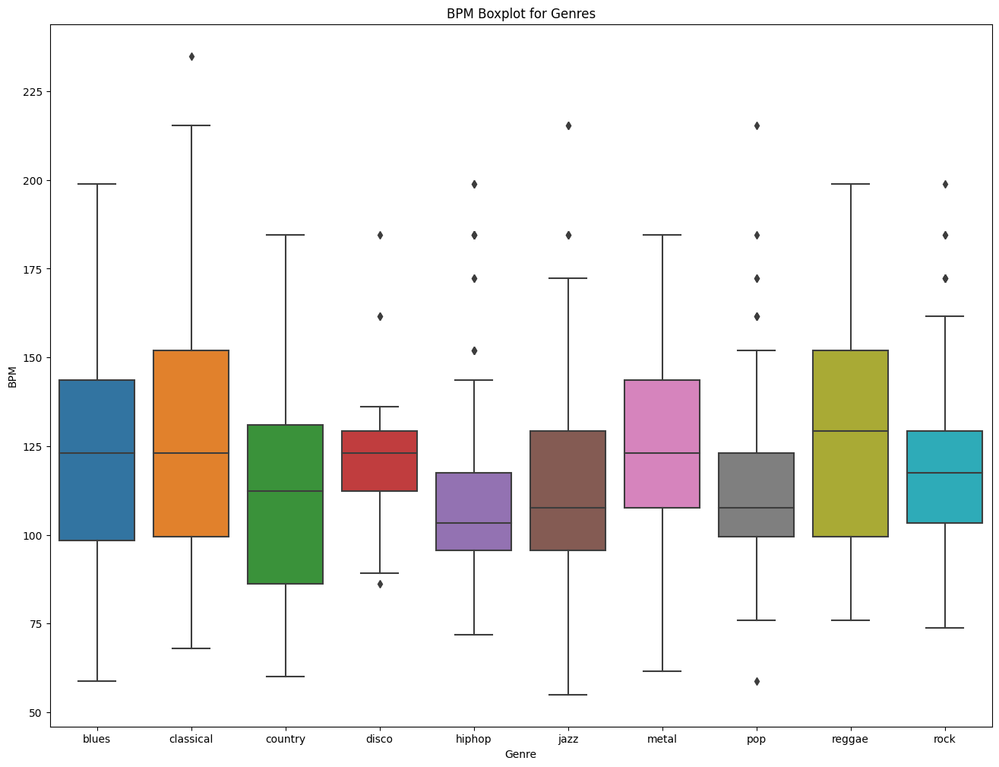

In [211]:
x = music_data[["label", "tempo"]]
f, ax = plt.subplots(figsize=(16, 12))
sns.boxplot(x = "label", y = "tempo", data = x)

plt.title('BPM Boxplot for Genres')
plt.xticks()
plt.yticks()
plt.xlabel("Genre" )
plt.ylabel("BPM")
plt.savefig("BPM Boxplot.jpg")

#### Audio Features of .wav Samples

In [214]:
audio,sr= librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
print('audio:', audio)
print('audio shape:', np.shape(audio))
print('Sample Rate (Hz):', sr)

# Verify length of the audio
print('Check Len of Audio:', SAMPLES_PER_TRACK/SAMPLE_RATE)

audio: [ 0.00732422  0.01660156  0.00762939 ... -0.05560303 -0.06106567
 -0.06417847]
audio shape: (661794,)
Sample Rate (Hz): 22050
Check Len of Audio: 30.0


##### Blues

In [215]:
data, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'blues'
filtered_data = music_data.loc[music_data['filename'].str.contains('blues', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


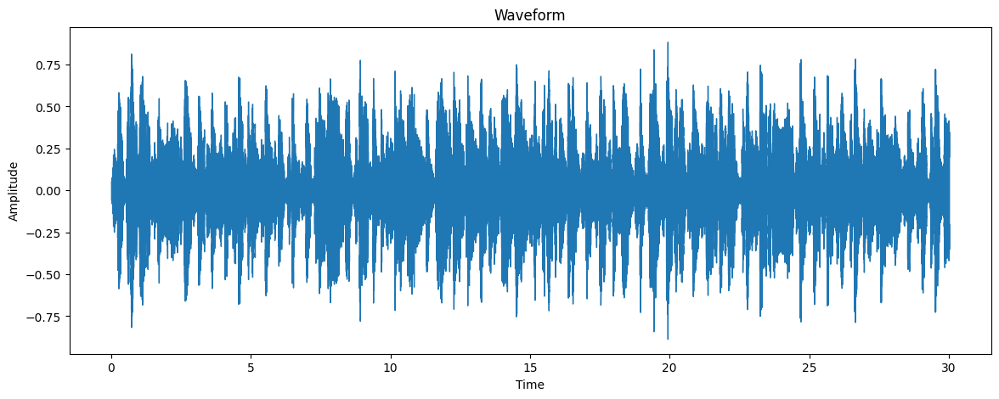

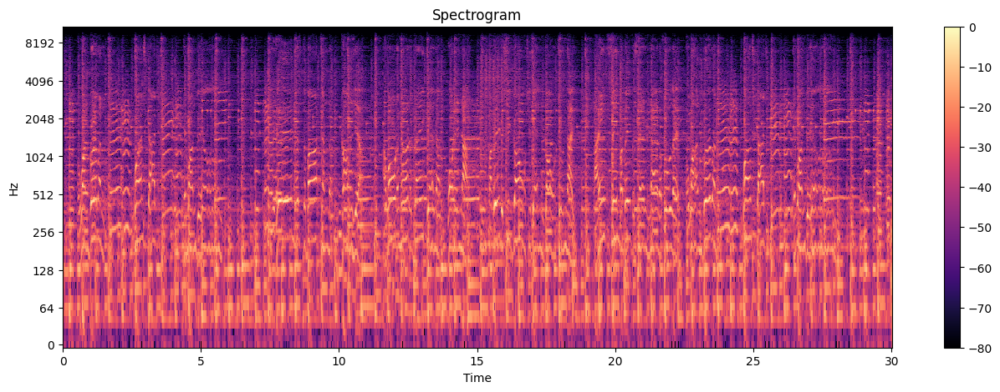

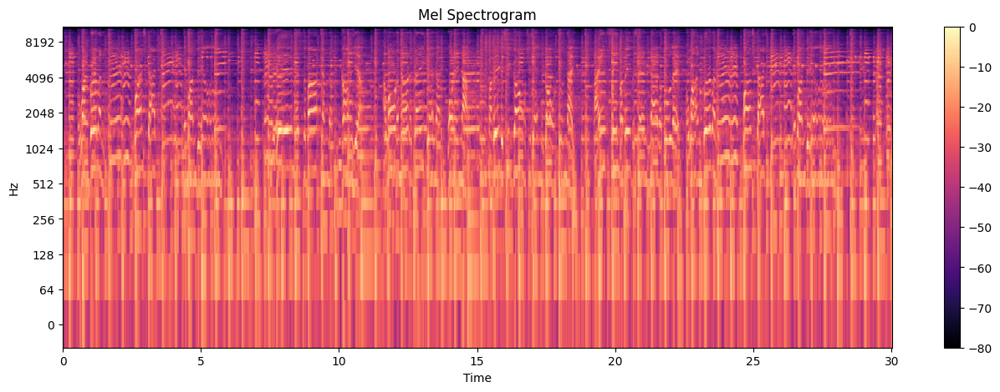

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


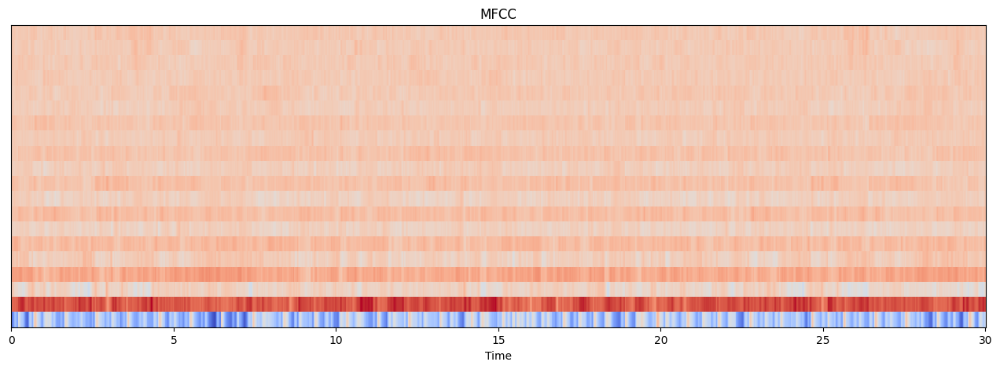

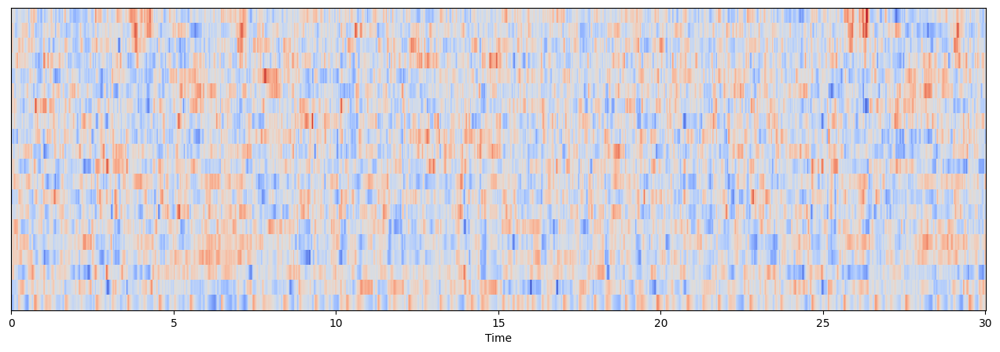

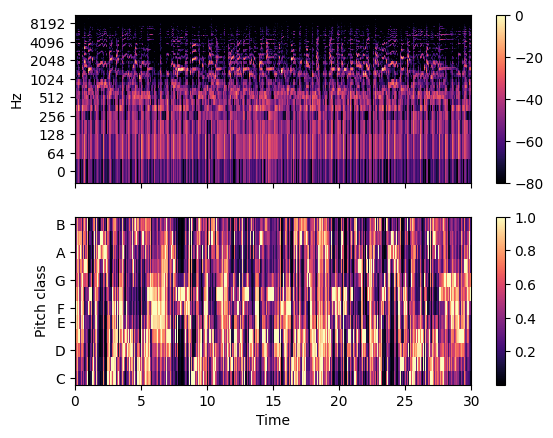

In [216]:
path = '/content/Data/genres_original/blues/blues.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
librosa.display.waveshow(x, sr=sr)

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

# zero_cross rates
#zero_crossings = librosa.zero_crossings(x, pad=False)
#print(sum(zero_crossings))

In [217]:
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
ipd.Audio(x, rate=sr)

##### Classical

In [218]:
data, sr = librosa.load('/content/Data/genres_original/classical/classical.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'classical'
filtered_data = music_data.loc[music_data['filename'].str.contains('classical', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
100,classical.00000.wav,661794,0.252392,0.084153,0.036245,0.000221,1505.166424,44457.891741,1559.005740,43682.973267,...,86.137909,-0.320783,100.827087,1.772985,95.440735,0.889234,97.133331,-0.842025,120.865791,classical
101,classical.00001.wav,661794,0.214995,0.085010,0.030625,0.000161,1360.643672,61611.212848,1441.243134,32378.729688,...,158.498138,-4.289846,75.676430,0.591009,134.617706,2.877631,153.630554,0.373281,123.707390,classical
102,classical.00002.wav,661794,0.277958,0.083759,0.043860,0.000193,1490.275364,38993.337531,1600.115744,31200.899044,...,85.150917,-1.309433,77.170746,2.945177,74.202652,-1.655027,59.096081,-2.896193,53.000435,classical
103,classical.00003.wav,661794,0.234229,0.083451,0.029442,0.000357,1526.629882,91344.309888,1499.439342,60196.227560,...,125.197098,0.597389,111.539612,-0.595684,151.719910,2.341259,133.902283,2.640536,210.365616,classical
104,classical.00004.wav,661794,0.221574,0.085000,0.042316,0.000209,1705.563259,68132.453459,1646.064010,25963.458284,...,83.138351,-4.125299,69.470551,-4.787771,131.776337,-4.774069,115.447807,-4.603727,217.122009,classical


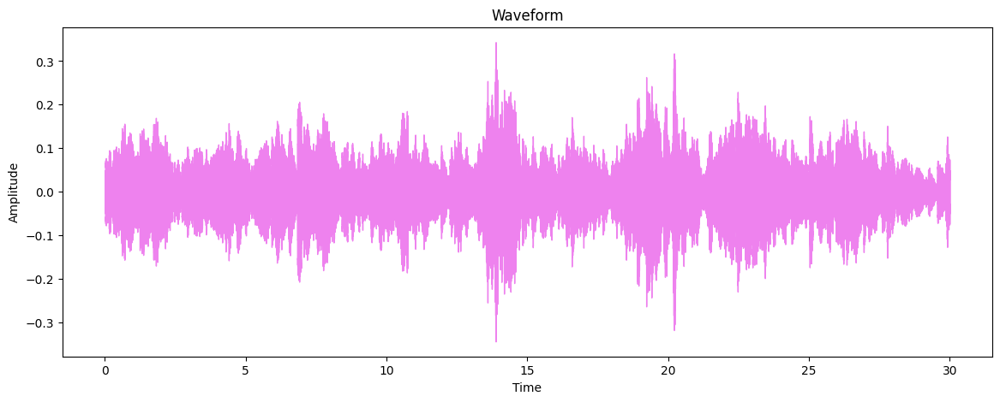

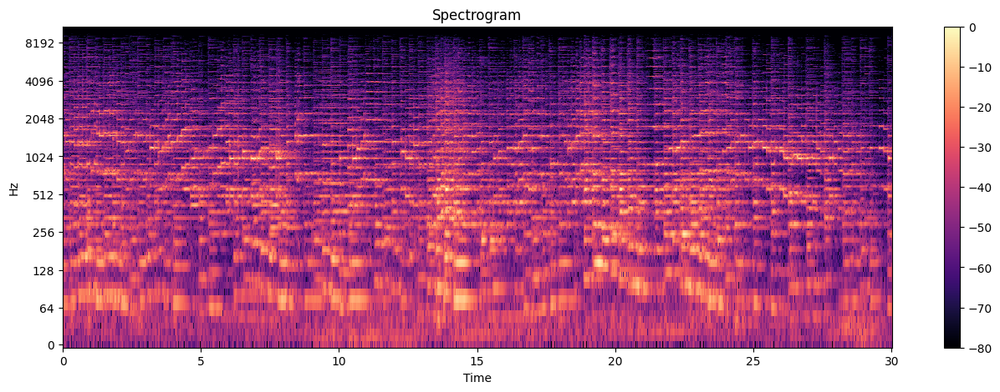

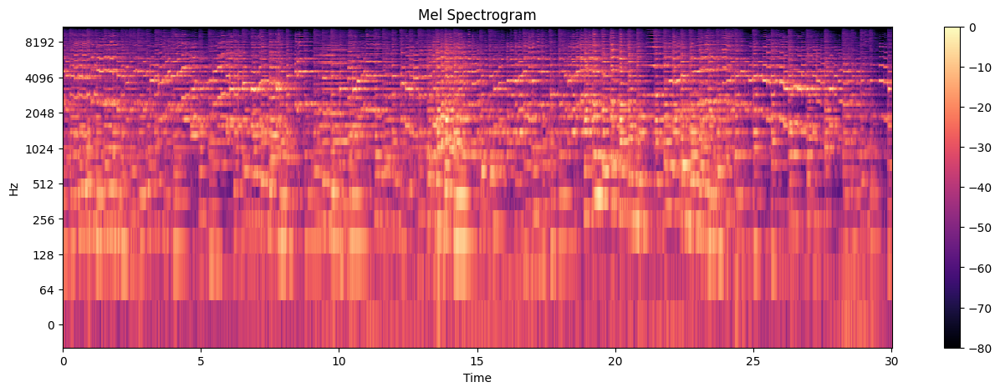

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


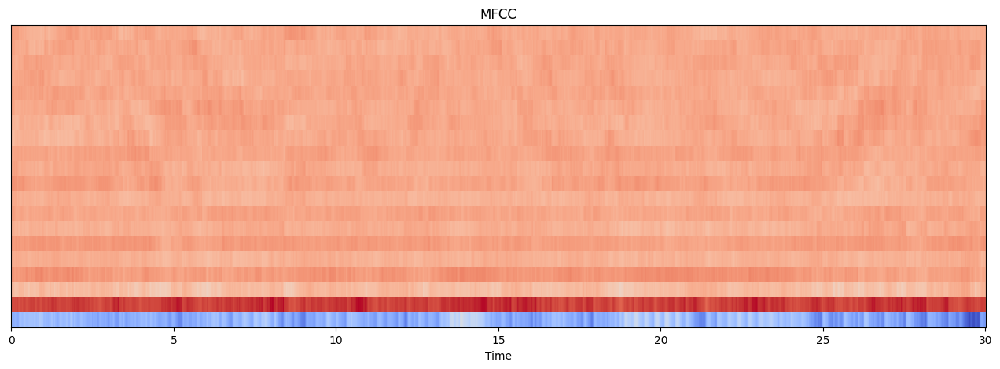

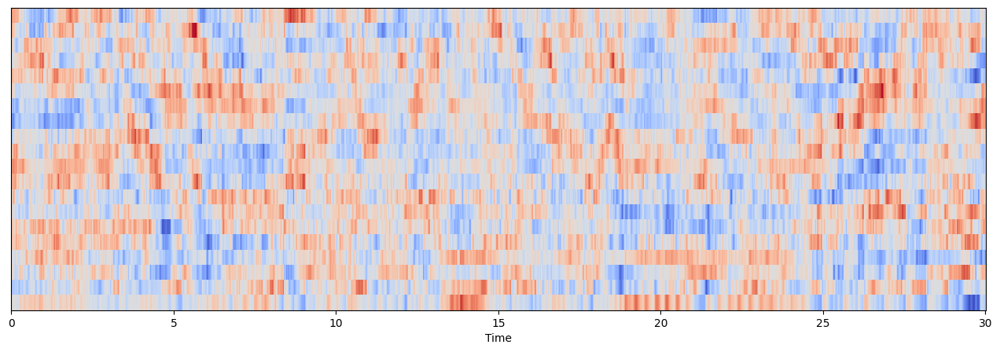

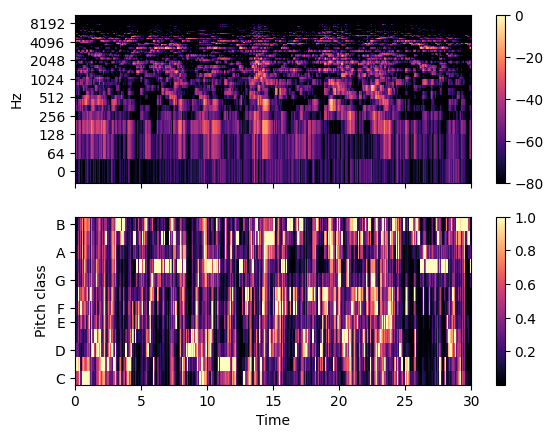

In [219]:
path = '/content/Data/genres_original/classical/classical.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='violet')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [220]:
x, sr = librosa.load('/content/Data/genres_original/classical/classical.00000.wav')
ipd.Audio(x, rate=sr)

##### Country

In [221]:
data, sr = librosa.load('/content/Data/genres_original/country/country.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'country'
filtered_data = music_data.loc[music_data['filename'].str.contains('country', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
200,country.00000.wav,663300,0.384027,0.081182,0.248418,0.000704,2797.844810,354673.043774,2847.551887,105651.317886,...,68.586594,0.615661,54.304928,4.062637,74.334892,0.909476,68.596603,4.095612,73.610832,country
201,country.00001.wav,661760,0.414032,0.079332,0.230516,0.000446,2938.155358,101837.490524,2839.657689,40987.078803,...,37.167381,-2.764677,46.065048,2.824268,48.752991,-1.738780,44.390938,0.974067,48.062492,country
202,country.00002.wav,669680,0.297045,0.097204,0.146586,0.001544,2308.673365,545384.343984,2618.607096,99595.722265,...,37.158360,-4.772855,35.958435,-0.286400,40.287098,-5.357112,43.693214,-1.965473,61.187630,country
203,country.00003.wav,661408,0.376894,0.083747,0.204364,0.001915,2174.033869,570638.884152,2280.888606,207005.343638,...,61.081104,-6.525970,63.754681,-0.034701,47.429501,-1.414051,41.131588,-3.078825,51.753349,country
204,country.00004.wav,661408,0.382781,0.081821,0.209498,0.000802,2966.086095,192897.128750,2848.106749,74510.070234,...,39.297134,-0.166441,43.141171,0.241561,48.237293,-5.440013,33.747955,1.827359,44.118107,country


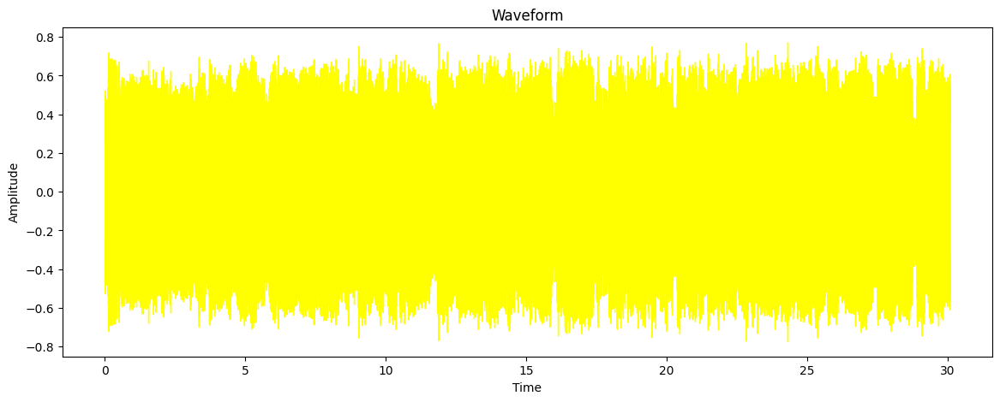

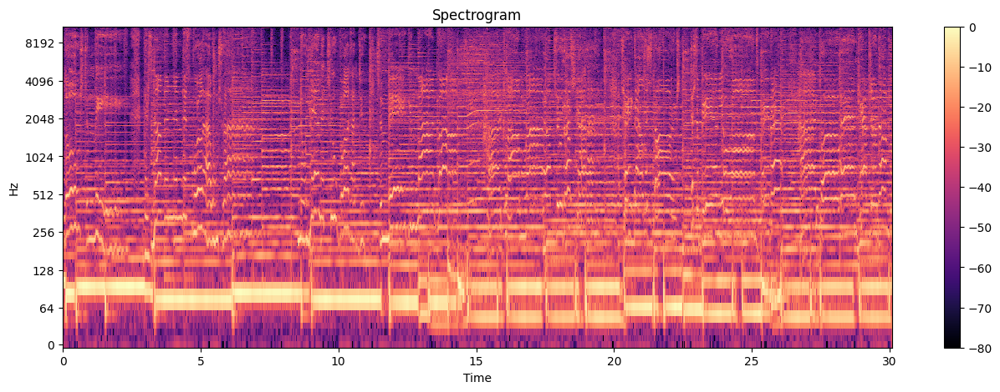

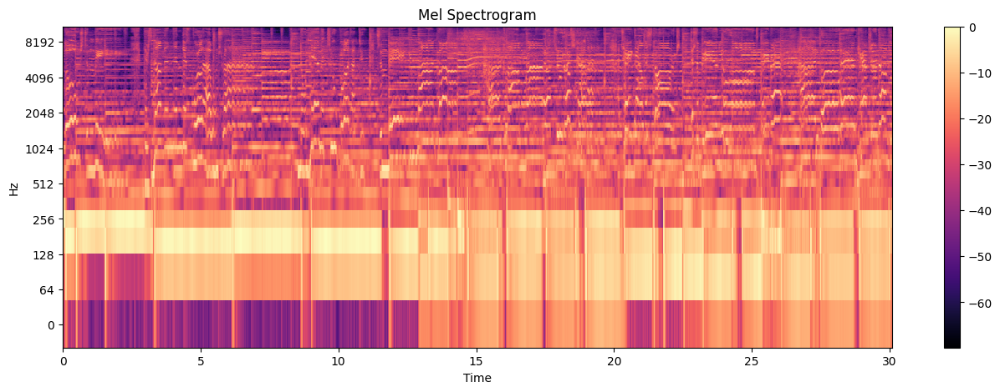

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


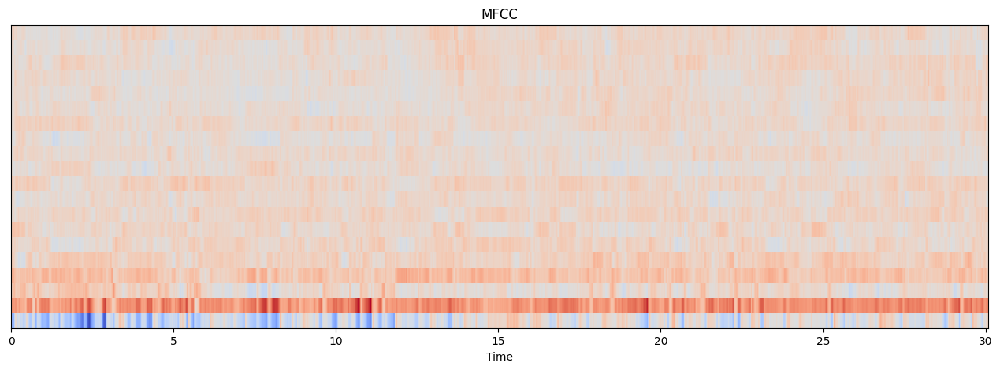

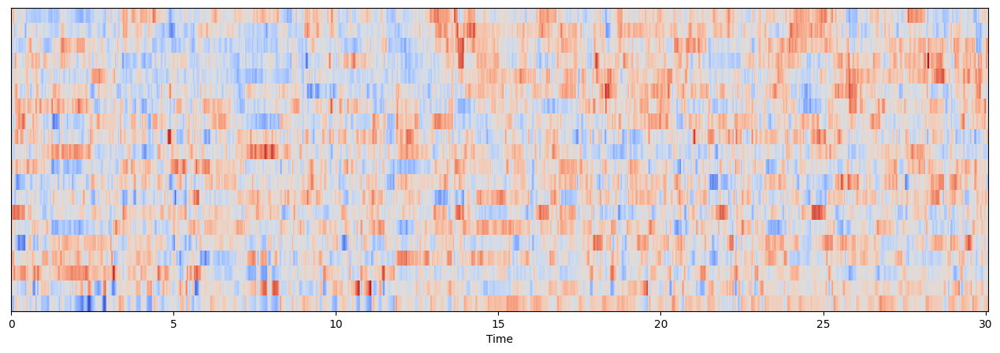

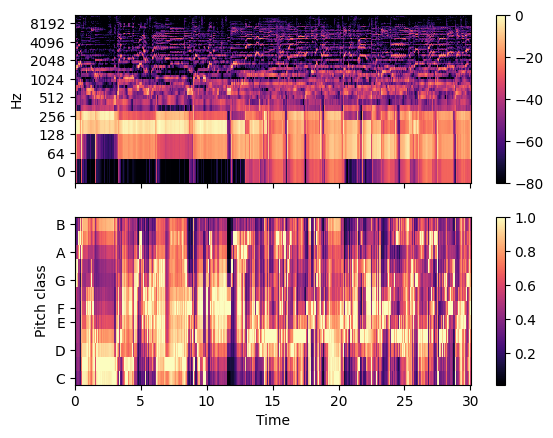

In [222]:
path = '/content/Data/genres_original/country/country.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='yellow')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [223]:
x, sr = librosa.load('/content/Data/genres_original/country/country.00000.wav')
ipd.Audio(x, rate=sr)

##### Hip-Hop

In [224]:
data, sr = librosa.load('/content/Data/genres_original/hiphop/hiphop.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'hiphop'
filtered_data = music_data.loc[music_data['filename'].str.contains('hiphop', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
400,hiphop.00000.wav,661504,0.460728,0.085172,0.125275,0.002465,2667.940502,4.185230e+05,2351.160744,107829.332778,...,55.406570,-5.377674,69.421989,7.692775,62.197952,-5.553035,63.344887,1.516093,41.072289,hiphop
401,hiphop.00001.wav,661504,0.457251,0.090083,0.285521,0.006891,2808.849567,9.392262e+05,2441.508002,158175.792905,...,66.535225,-7.046246,67.616226,4.735236,58.401016,1.867201,57.100945,0.030806,67.664940,hiphop
402,hiphop.00002.wav,661504,0.404255,0.092196,0.093516,0.001122,1490.156547,6.335591e+05,1909.978526,233181.638022,...,54.918308,-6.975131,61.616516,0.395021,41.194897,-2.430323,41.611870,-2.932962,38.757835,hiphop
403,hiphop.00003.wav,661504,0.467288,0.091837,0.266418,0.013460,2492.860234,4.953543e+05,2330.007272,194898.652582,...,102.317482,0.637127,60.690502,0.261578,62.055466,-5.102053,57.268295,-4.016594,57.155560,hiphop
404,hiphop.00004.wav,661504,0.449220,0.093491,0.200710,0.015462,2372.067953,1.073302e+06,2358.265792,368608.137635,...,72.039268,-0.824717,60.974304,1.636430,65.641922,-4.067124,59.489983,1.123676,81.820488,hiphop


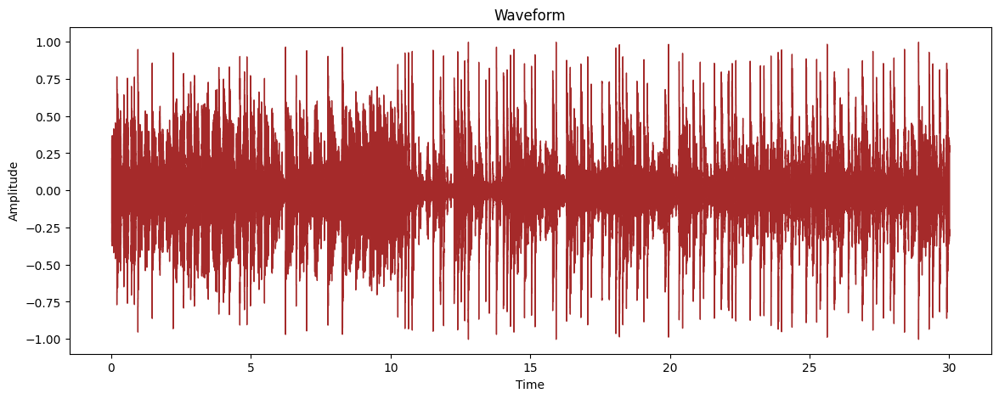

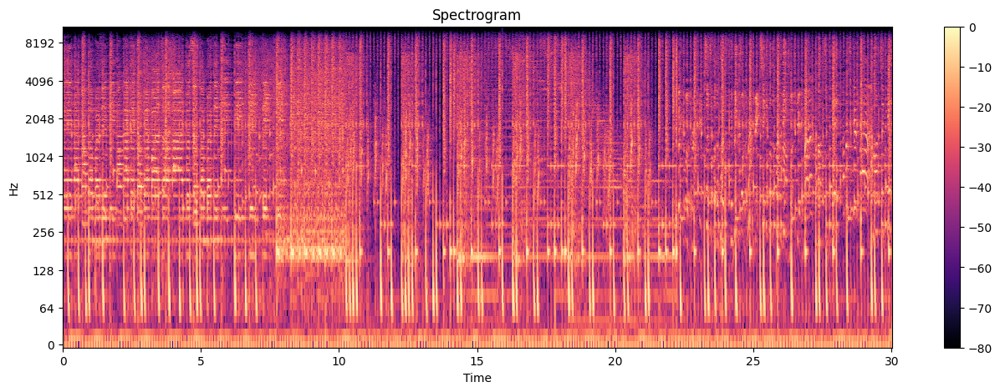

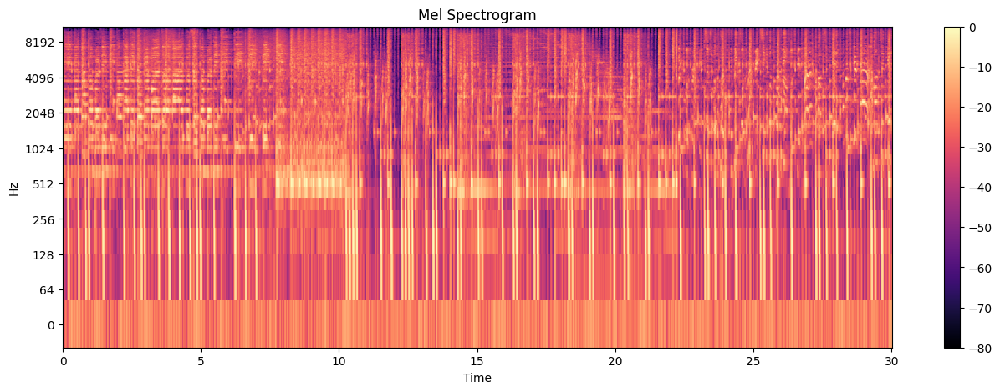

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


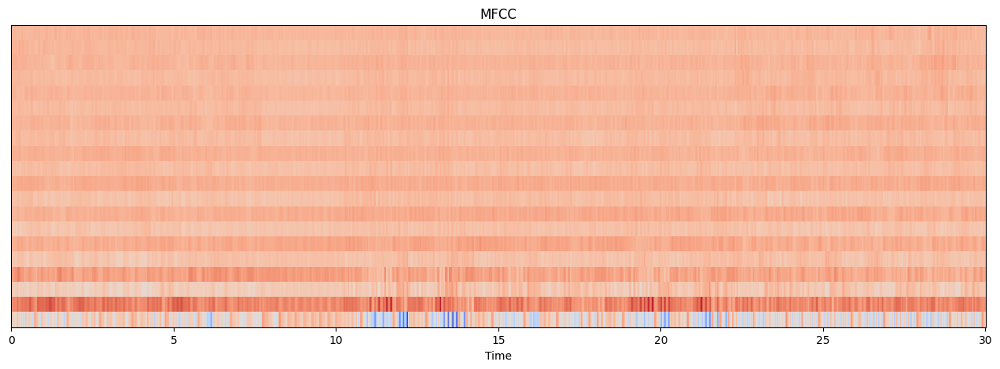

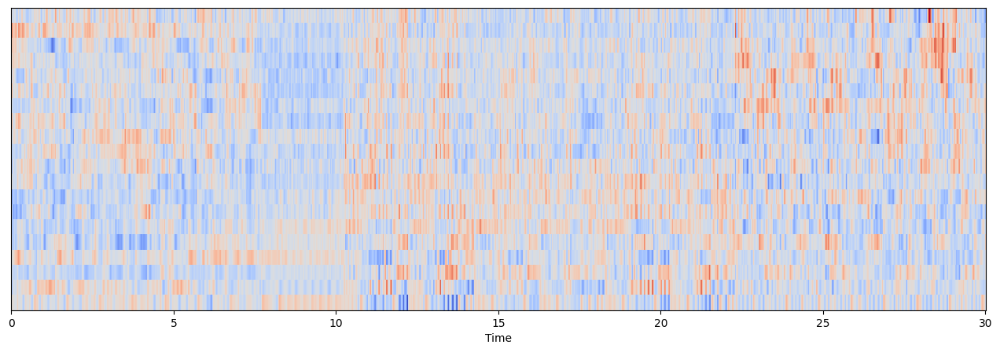

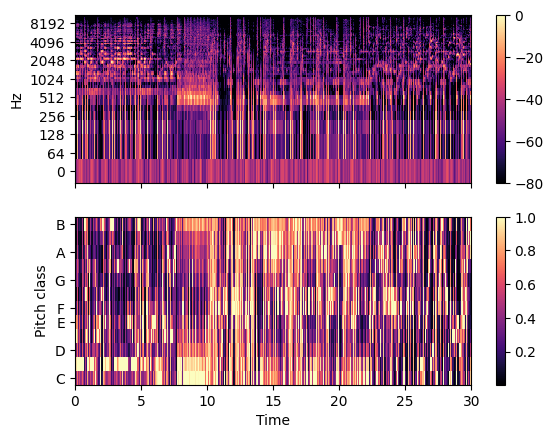

In [225]:
path = '/content/Data/genres_original/hiphop/hiphop.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='Brown')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [226]:
x, sr = librosa.load('/content/Data/genres_original/hiphop/hiphop.00000.wav')
ipd.Audio(x, rate=sr)

##### Disco

In [227]:
data, sr = librosa.load('/content/Data/genres_original/disco/disco.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')
# Filter the data for entries where the 'filename' column contains 'disco'
filtered_data = music_data.loc[music_data['filename'].str.contains('disco', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
300,disco.00000.wav,664180,0.445477,0.087835,0.142184,0.004136,2297.869205,898837.892920,2565.714338,192600.476879,...,39.548061,-5.322056,32.328892,1.239463,41.781643,-5.596891,41.700623,-3.592718,30.864504,disco
301,disco.00001.wav,666160,0.410686,0.086704,0.177221,0.002626,3292.625967,552485.340227,2768.043874,137858.408766,...,61.247005,-0.391182,93.372681,2.636313,84.270859,-3.362998,68.558182,-0.089296,82.244934,disco
302,disco.00002.wav,661794,0.412079,0.084436,0.161325,0.002180,3592.101258,497829.301850,3398.440463,70133.641878,...,25.199570,-1.233337,26.995438,-3.362679,35.830299,-3.735123,61.145828,-1.449847,51.829914,disco
303,disco.00003.wav,668140,0.495037,0.077002,0.196364,0.002079,3045.769505,784632.948938,2720.353316,139449.914856,...,35.344189,-2.035989,32.215935,-3.349386,43.756260,-4.155849,47.279202,-0.357712,53.524834,disco
304,disco.00004.wav,661794,0.382107,0.088899,0.114597,0.003200,3328.485124,640715.167250,3111.695357,133835.636271,...,43.114391,-1.565166,56.410801,0.561841,48.362068,0.300277,57.832367,-2.782476,47.766579,disco


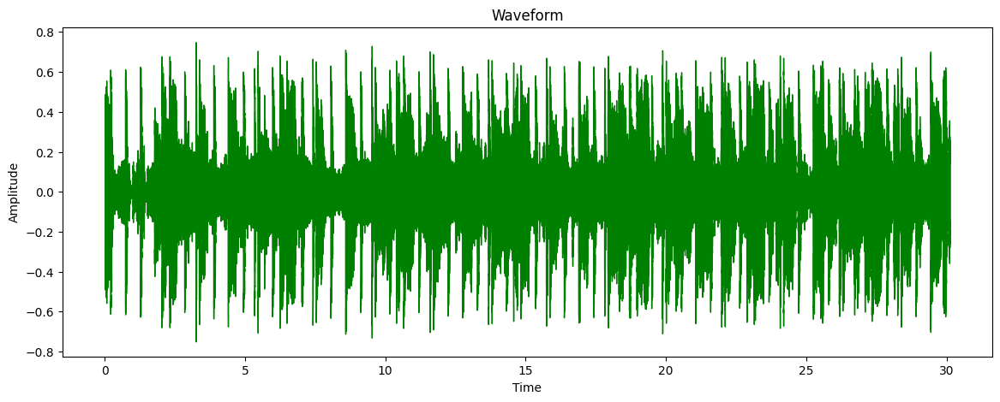

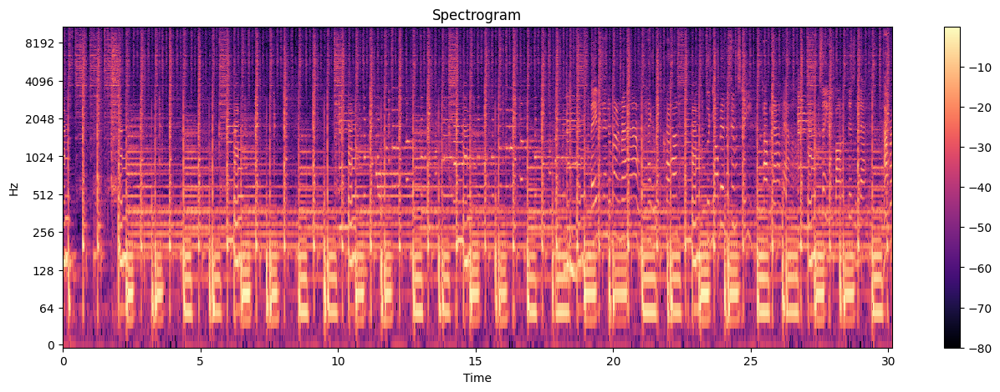

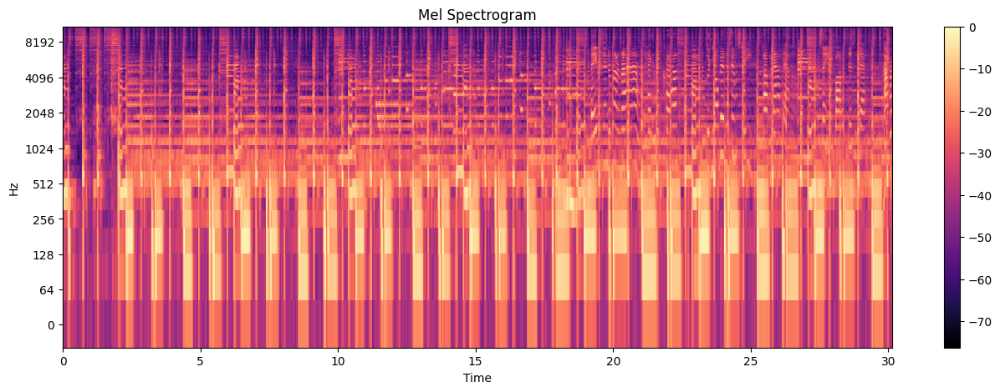

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


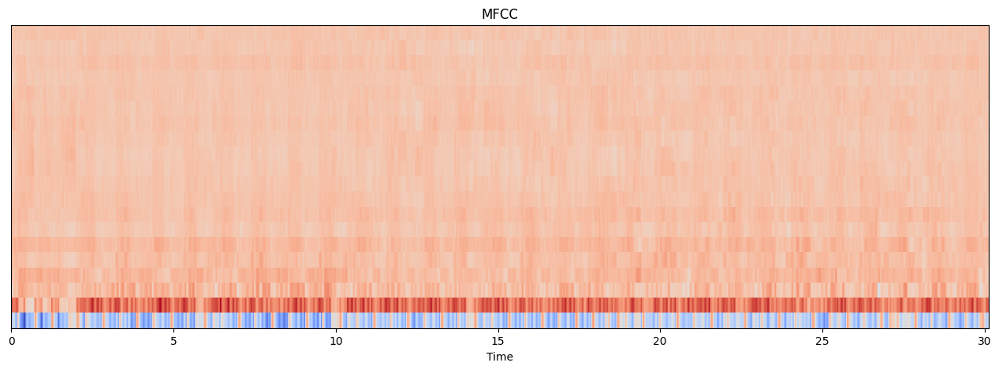

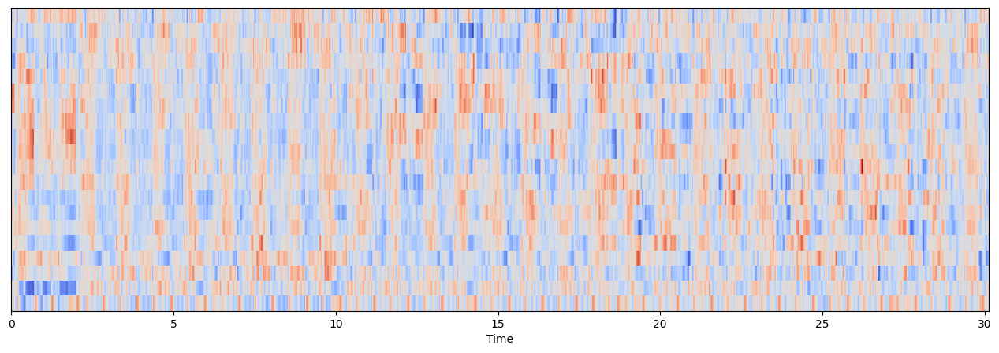

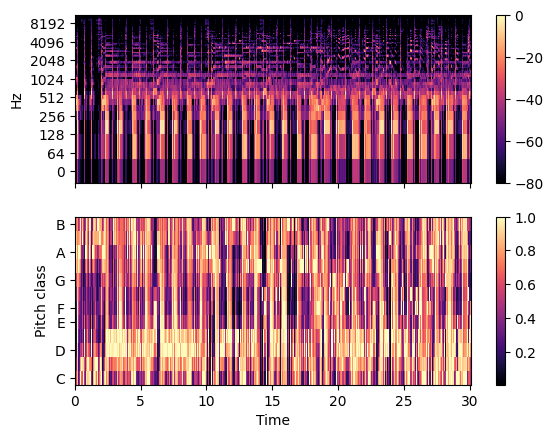

In [228]:
path = '/content/Data/genres_original/disco/disco.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='green')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [229]:
x, sr = librosa.load('/content/Data/genres_original/disco/disco.00000.wav')
ipd.Audio(x, rate=sr)

##### Reggae

In [230]:
data, sr = librosa.load('/content/Data/genres_original/reggae/reggae.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'reggae'
filtered_data = music_data.loc[music_data['filename'].str.contains('reggae', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
800,reggae.00000.wav,661794,0.329137,0.090313,0.094154,0.001773,2133.200382,276253.439506,2289.540104,130964.269614,...,67.178230,-9.199856,89.098007,3.286665,75.316483,-0.759790,86.541344,3.761663,104.204071,reggae
801,reggae.00001.wav,661794,0.348960,0.088220,0.082020,0.001613,1638.907439,409140.440696,1995.201491,213841.434410,...,48.900383,-9.744484,51.981590,-3.916737,60.235485,-7.651851,62.772423,-3.549433,55.385967,reggae
802,reggae.00002.wav,661794,0.378536,0.092250,0.092481,0.001832,1796.838299,427414.586884,2103.089979,152693.460470,...,59.913940,-3.206988,88.169411,2.696751,93.041008,-3.982512,56.710304,2.865026,72.069252,reggae
803,reggae.00003.wav,661794,0.391410,0.093633,0.094226,0.002161,1923.341464,689480.351191,2107.911578,303982.233052,...,78.756287,-5.853744,67.545120,1.040419,67.730591,-2.976455,77.732491,-1.359459,95.659546,reggae
804,reggae.00004.wav,661794,0.401963,0.093053,0.101107,0.002732,2009.585992,491386.403091,2141.377602,179690.822659,...,84.130760,-3.370105,86.956825,12.441627,93.374908,-3.351832,70.833794,0.741723,89.512894,reggae


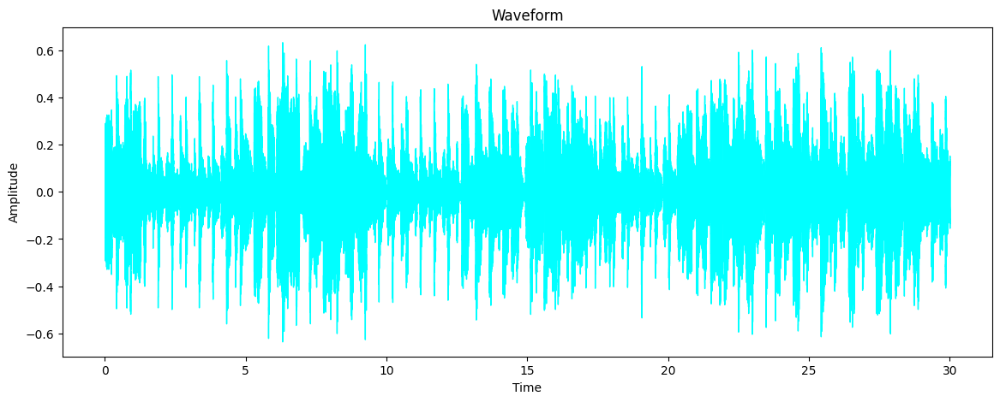

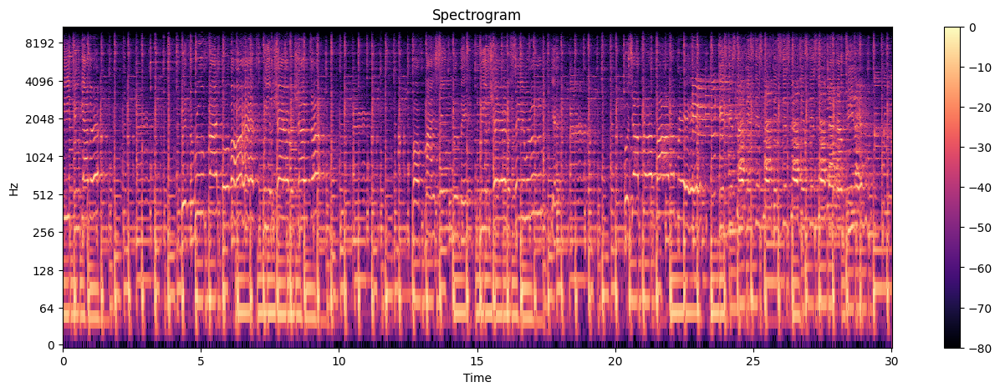

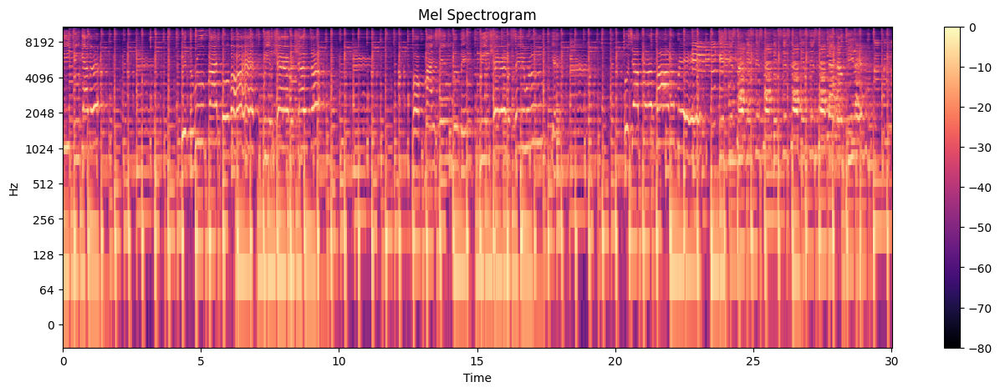

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


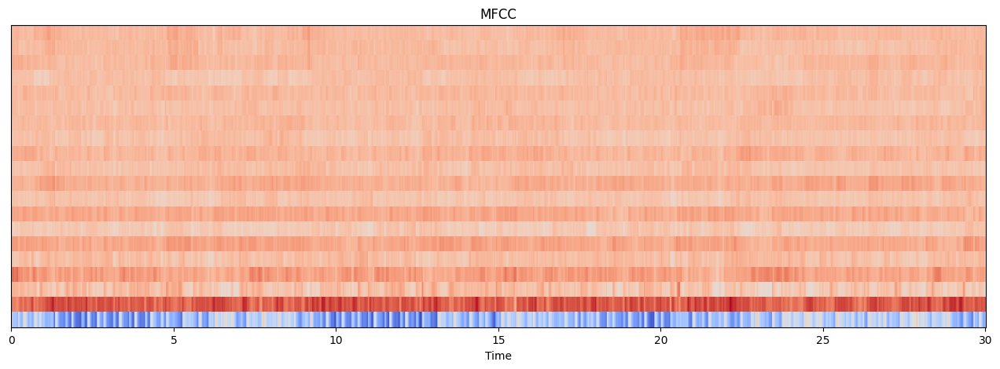

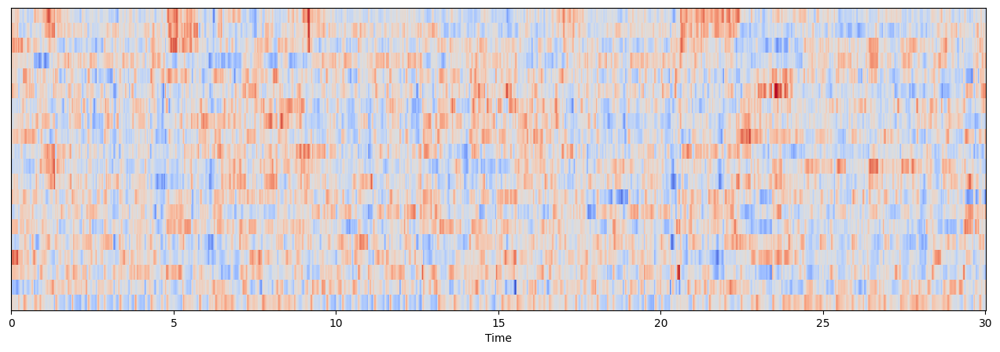

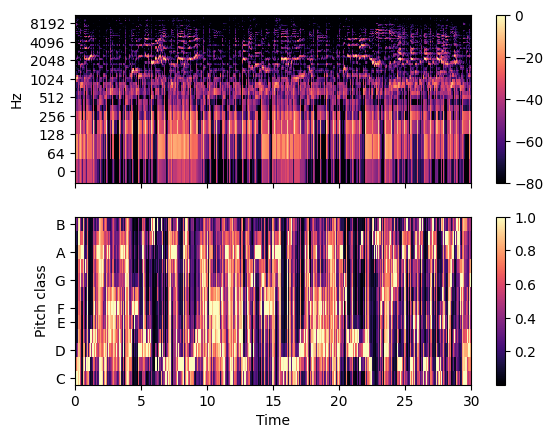

In [231]:
path = '/content/Data/genres_original/reggae/reggae.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='aqua')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [232]:
x, sr = librosa.load('/content/Data/genres_original/reggae/reggae.00000.wav')
ipd.Audio(x, rate=sr)

##### Pop

In [233]:
data, sr = librosa.load('/content/Data/genres_original/pop/pop.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'pop'
filtered_data = music_data.loc[music_data['filename'].str.contains('pop', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
700,pop.00000.wav,661504,0.389631,0.090863,0.185917,0.007513,3421.887738,1.080267e+06,3409.775605,163694.297157,...,112.463516,2.514723,92.615662,4.111930,113.117233,9.181066,87.627289,4.741255,88.584061,pop
701,pop.00001.wav,661504,0.412993,0.097699,0.262579,0.014924,3702.105111,1.404155e+06,3431.856264,179373.095619,...,129.778473,5.566532,205.448044,3.822952,170.974274,5.576165,166.527878,4.927082,155.335678,pop
702,pop.00002.wav,661504,0.417771,0.093556,0.215172,0.006579,3214.086840,1.006318e+06,3269.678966,107054.369743,...,94.625061,1.415107,72.024689,2.811311,58.061012,-1.410339,44.048363,-3.386550,46.421040,pop
703,pop.00003.wav,661504,0.409812,0.081134,0.129422,0.001808,1836.956691,7.874765e+05,2066.669705,408916.095988,...,68.658119,4.753404,77.756416,-3.510077,71.796509,4.904540,61.578075,-3.211654,61.053921,pop
704,pop.00004.wav,661504,0.384296,0.083575,0.211175,0.002561,2753.120791,7.178949e+05,2861.501507,149359.339153,...,47.624577,-1.329443,36.215866,-0.874240,43.780357,0.691995,53.095066,-1.774849,48.859238,pop


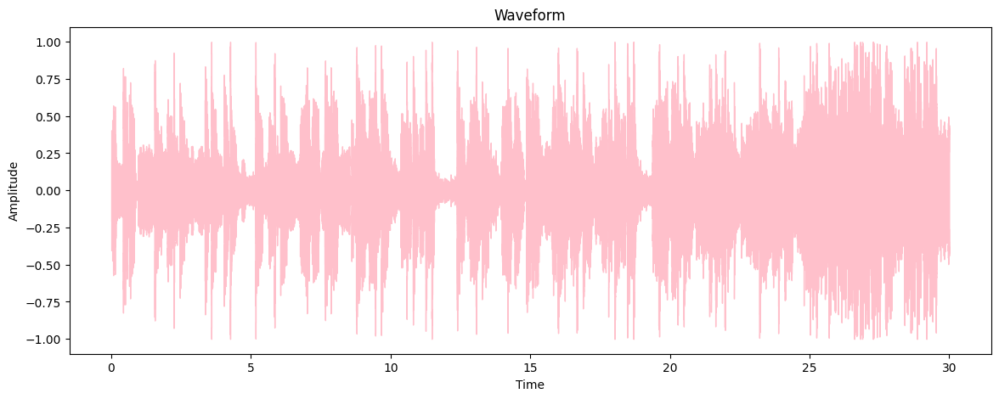

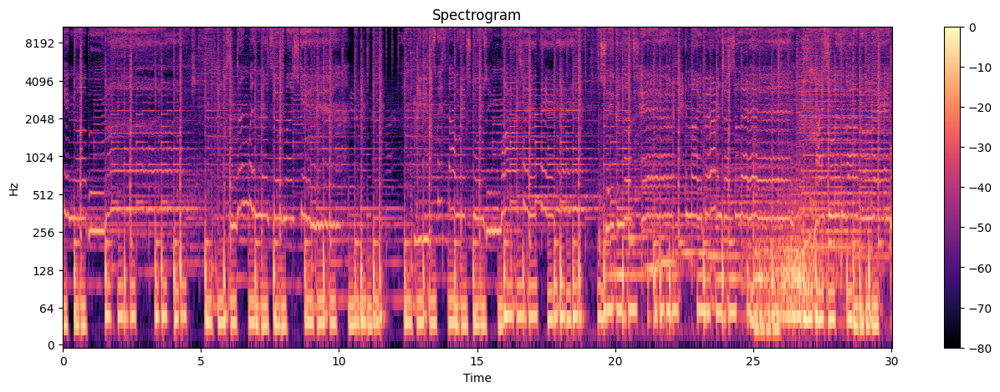

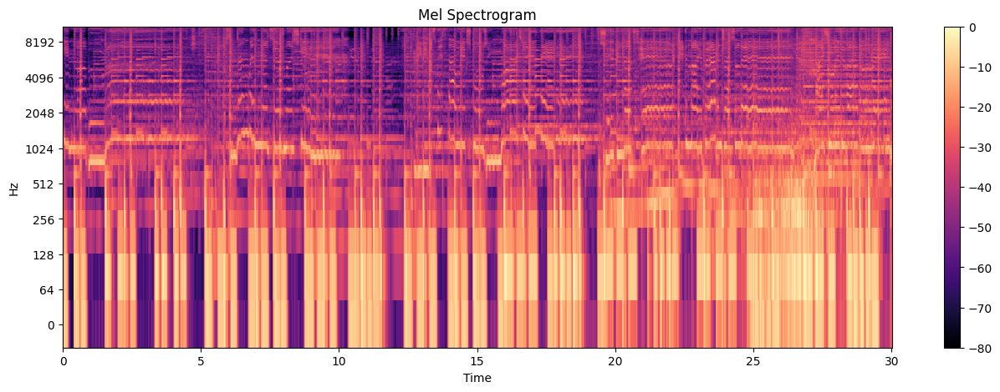

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


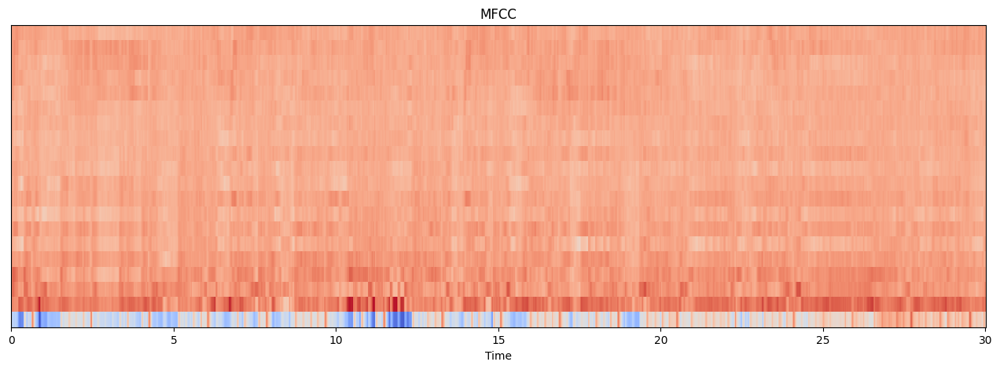

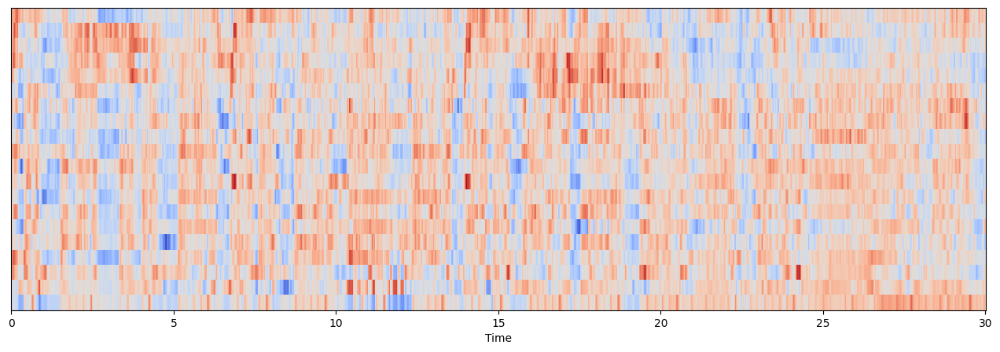

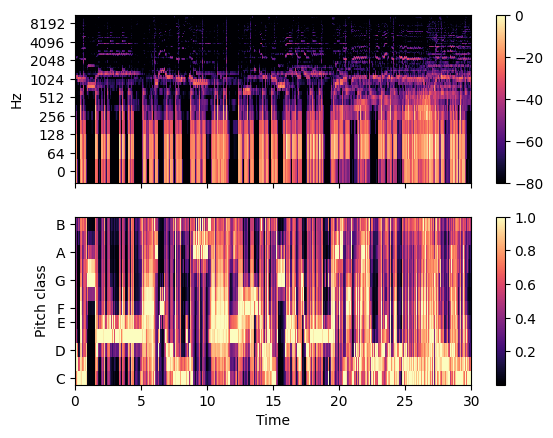

In [234]:
path = '/content/Data/genres_original/pop/pop.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='pink')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [235]:
x, sr = librosa.load('/content/Data/genres_original/pop/pop.00000.wav')
ipd.Audio(x, rate=sr)

##### Metal

In [236]:
data, sr = librosa.load('/content/Data/genres_original/jazz/jazz.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'metal'
filtered_data = music_data.loc[music_data['filename'].str.contains('metal', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
600,metal.00000.wav,661504,0.487716,0.067452,0.116125,0.000303,3274.488271,268188.963109,2722.524604,151283.782074,...,47.402462,-4.485988,41.050411,4.707357,36.572578,-2.754580,44.846279,0.499856,37.089111,metal
601,metal.00001.wav,661504,0.476903,0.071958,0.097298,0.000218,2922.845195,183896.529457,2620.939220,49910.397474,...,37.298557,-9.028761,37.896343,5.506845,34.330849,-6.194880,43.079819,3.124241,40.535103,metal
602,metal.00002.wav,661504,0.432415,0.074974,0.132810,0.000639,2198.918006,146483.728013,2006.406468,81102.756463,...,35.706135,-3.469525,33.916672,6.570201,38.387115,-6.574109,40.787182,2.962940,33.577770,metal
603,metal.00003.wav,661504,0.487554,0.078893,0.150183,0.000851,2752.264617,155540.402763,2205.786688,29377.697089,...,39.496056,-6.667662,39.869370,5.282710,50.354977,-2.324664,41.388176,3.579682,41.606361,metal
604,metal.00004.wav,661504,0.634766,0.048010,0.063476,0.000107,3403.073174,267804.428424,2825.134867,53354.067018,...,36.831020,-6.623356,39.403965,4.545003,32.381054,-4.264578,30.510605,4.288738,32.458736,metal


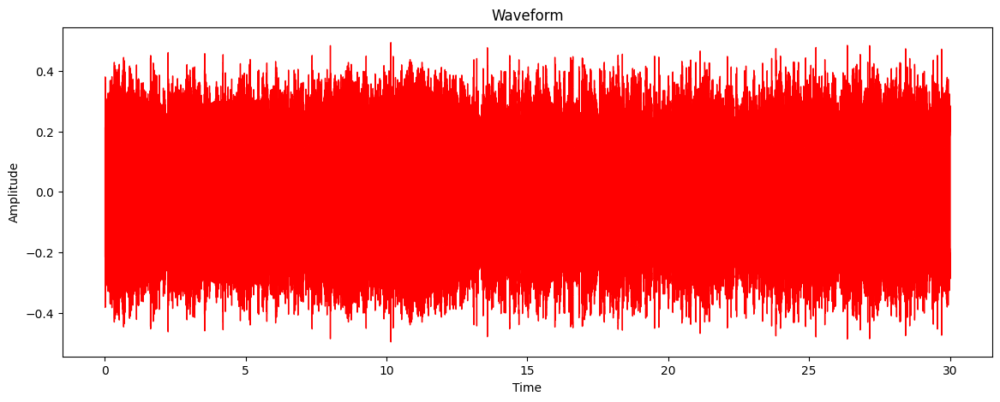

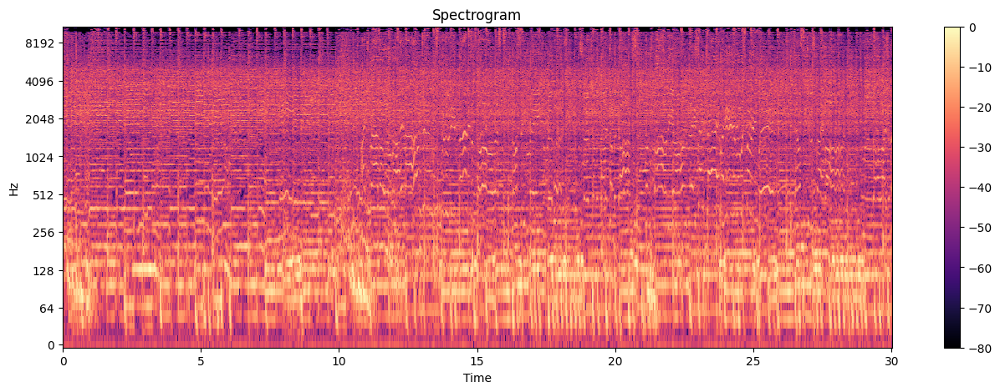

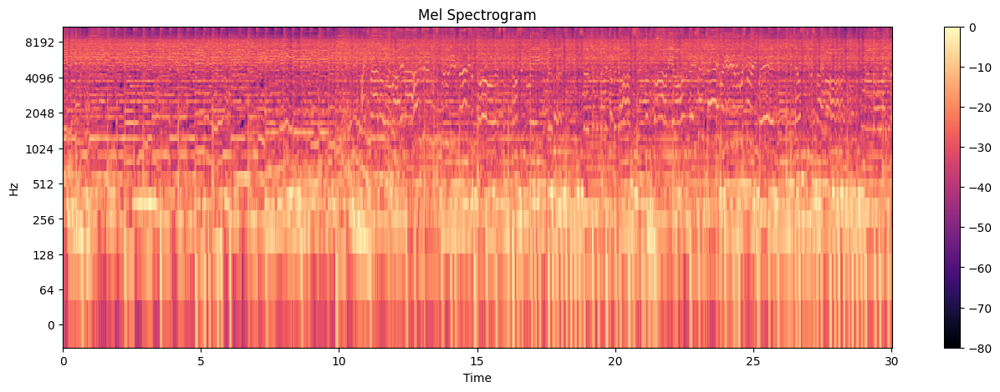

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


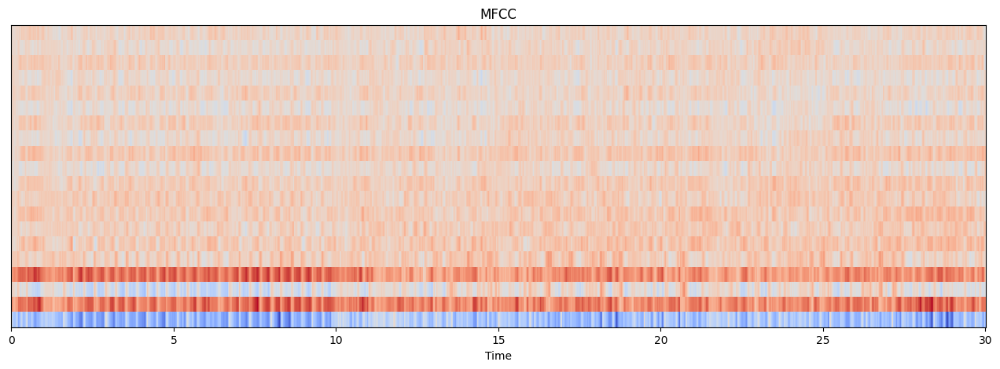

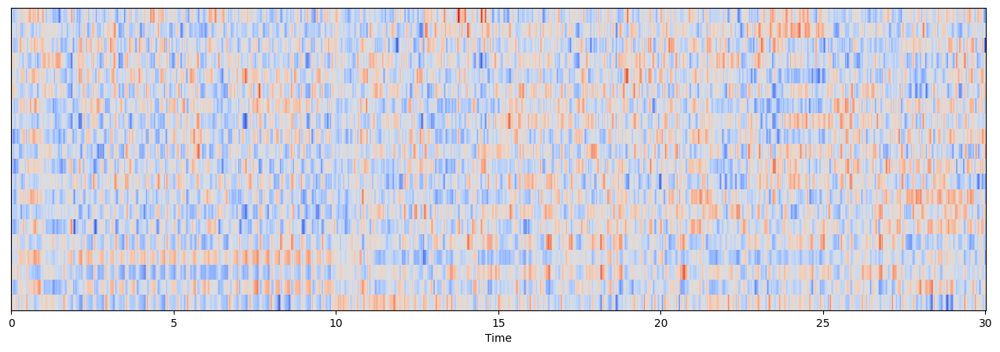

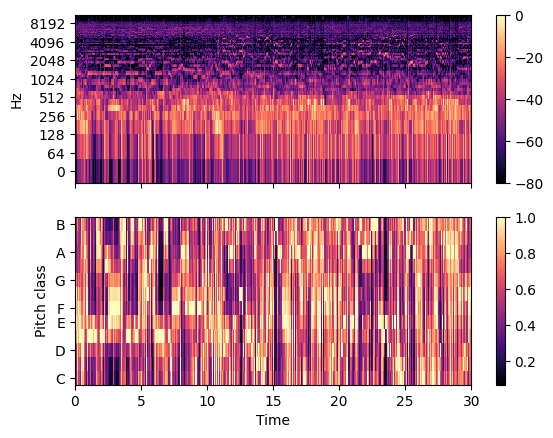

In [237]:
path = '/content/Data/genres_original/metal/metal.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='red')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [238]:
x, sr = librosa.load('/content/Data/genres_original/metal/metal.00000.wav')
ipd.Audio(x, rate=sr)

##### Jazz

In [239]:
data, sr = librosa.load('/content/Data/genres_original/jazz/jazz.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'jazz'
filtered_data = music_data.loc[music_data['filename'].str.contains('jazz', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
500,jazz.00000.wav,661794,0.344511,0.085002,0.046747,0.001542,1503.869486,554576.511533,1754.216082,283554.933422,...,50.311016,-1.503434,41.141155,0.221949,55.707256,-1.991485,50.006485,-3.353825,49.906403,jazz
501,jazz.00001.wav,661794,0.327992,0.086563,0.022795,0.000239,1266.582864,301864.438070,1691.436718,217152.759634,...,44.129852,-5.185927,43.308018,-5.420732,45.753654,-3.113020,52.689682,-0.798190,98.281067,jazz
502,jazz.00002.wav,661794,0.267729,0.083935,0.080847,0.000992,1064.668667,161084.080653,1050.323423,62123.172997,...,39.962105,-12.292102,54.747944,-6.765346,45.726154,-3.496989,41.440159,-8.645325,73.411758,jazz
503,jazz.00003.wav,661794,0.319254,0.081004,0.059467,0.001298,813.063334,92946.251509,1058.892383,219831.952123,...,47.312241,-2.271646,54.591846,3.882905,38.849575,0.343479,50.033527,-2.221775,56.329369,jazz
504,jazz.00004.wav,661794,0.171939,0.082623,0.108776,0.002177,1039.263106,122594.590614,1421.998044,77384.236997,...,162.883072,1.981593,181.102692,4.976831,162.279419,6.577829,393.161987,-2.425600,472.822266,jazz


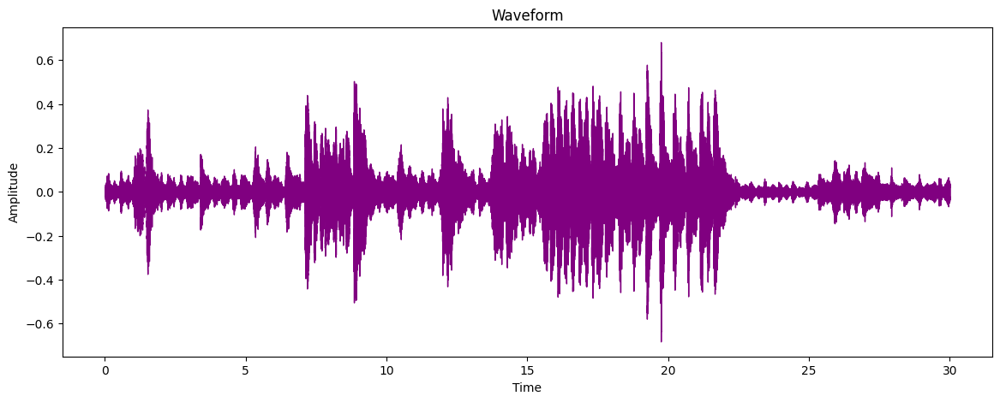

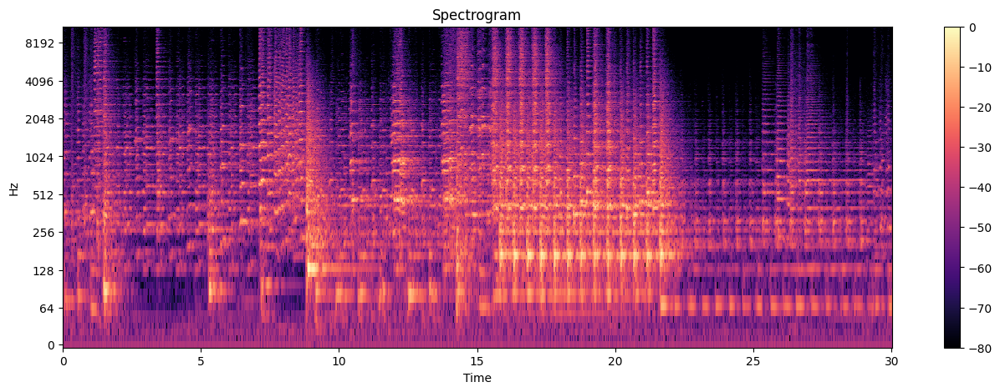

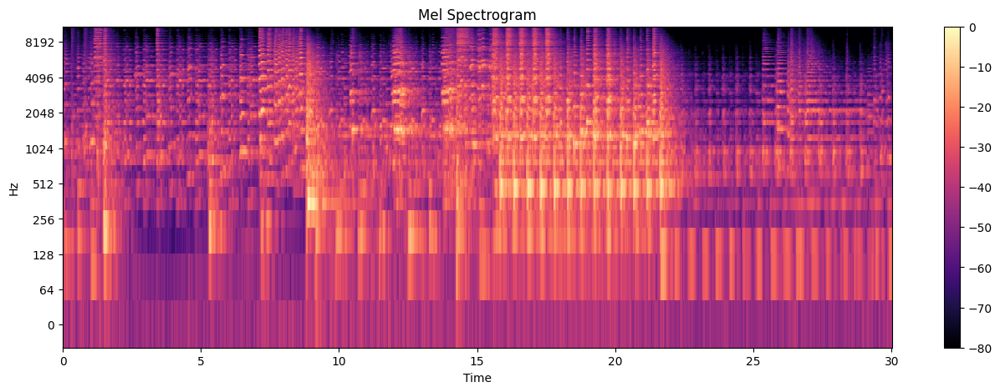

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


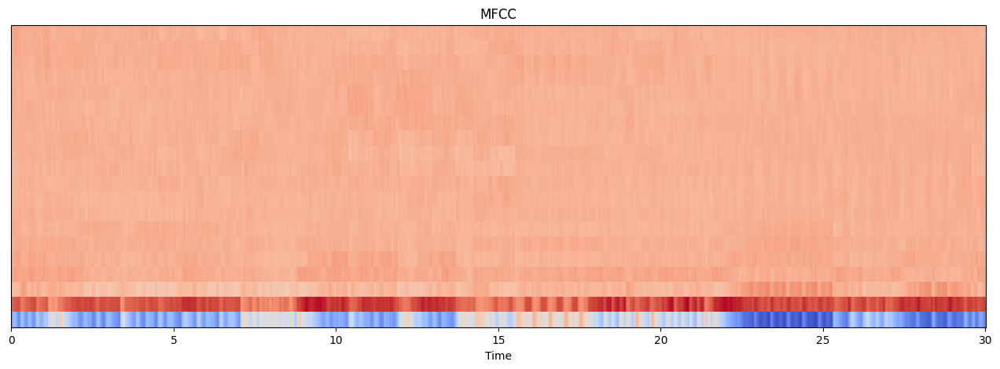

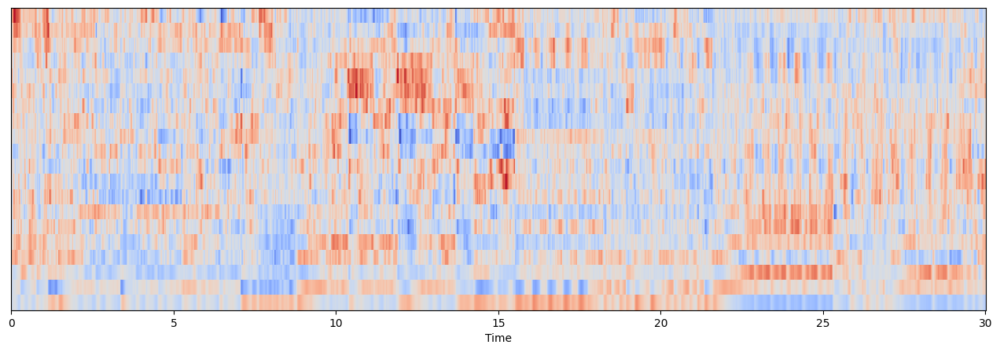

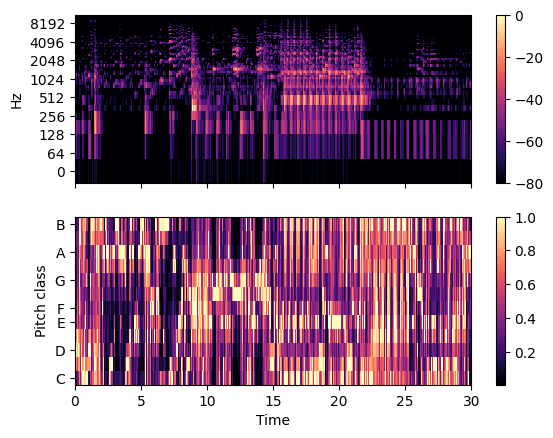

In [240]:
path = '/content/Data/genres_original/jazz/jazz.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='purple')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [241]:
x, sr = librosa.load('/content/Data/genres_original/jazz/jazz.00000.wav')
ipd.Audio(x, rate=sr)

##### Rock

In [242]:
data, sr = librosa.load('/content/Data/genres_original/rock/rock.00000.wav')
music_data = pd.read_csv('/content/Data/features_30_sec.csv')

# Filter the data for entries where the 'filename' column contains 'rock'
filtered_data = music_data.loc[music_data['filename'].str.contains('rock', case=False, regex=False)]
filtered_data.head(5)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
900,rock.00000.wav,661794,0.387577,0.085947,0.129127,0.005176,1996.327664,253317.046573,2097.080528,96097.543570,...,72.018906,-7.954800,35.664963,2.088888,32.998192,-2.400473,30.493656,-1.545837,57.983974,rock
901,rock.00001.wav,661794,0.365396,0.092115,0.180470,0.004920,1529.474961,226975.980892,1845.614892,118302.876157,...,28.202349,-4.949003,38.247959,-1.478706,38.036983,0.093757,31.638021,-5.355480,37.853733,rock
902,rock.00002.wav,661794,0.436806,0.086603,0.148662,0.006555,1875.315631,469319.088058,1983.973789,168248.258342,...,32.975990,-2.236184,46.028484,1.050915,48.065933,-1.652950,32.407761,-0.040473,31.185984,rock
903,rock.00003.wav,661794,0.379949,0.098387,0.151299,0.003987,1421.445980,428116.802500,1902.678467,172163.198782,...,28.271057,-2.437564,33.099937,-0.724597,33.062683,-1.420623,39.440090,0.652951,35.974148,rock
904,rock.00004.wav,661794,0.372798,0.089463,0.208739,0.001812,1345.693061,476303.495413,1841.674809,166605.306248,...,37.788227,-5.316258,46.373756,-0.845729,43.074821,-4.655758,27.223850,-4.789689,27.622538,rock


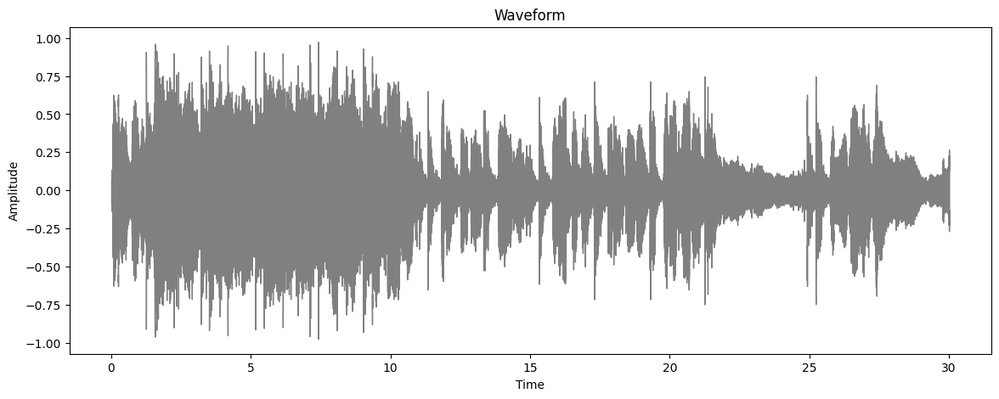

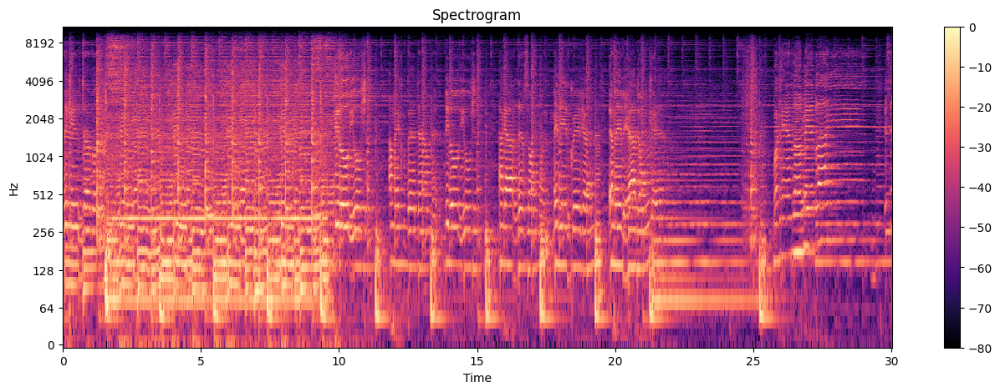

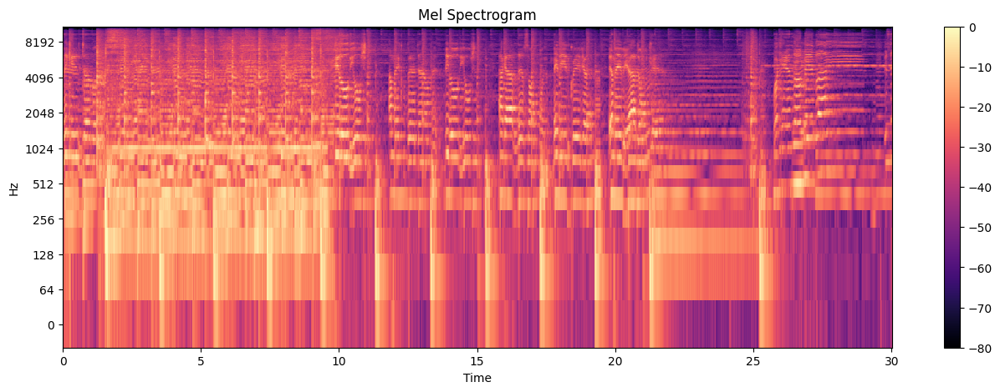

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


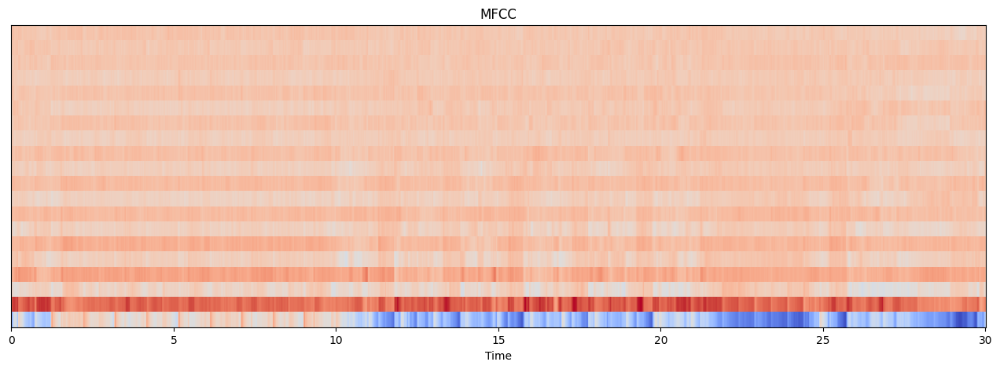

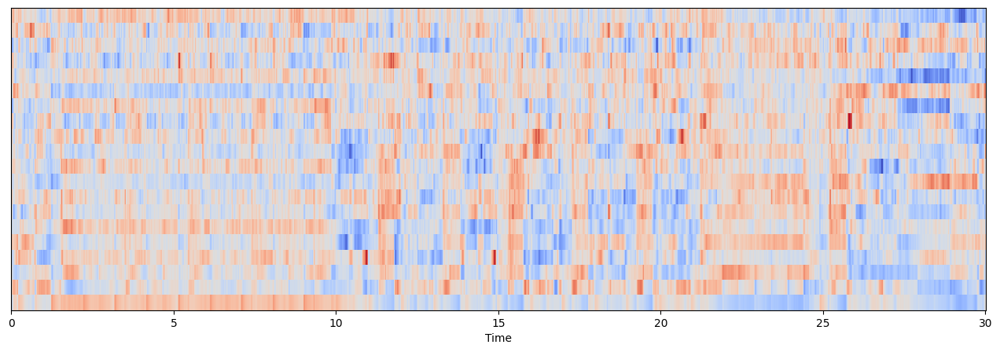

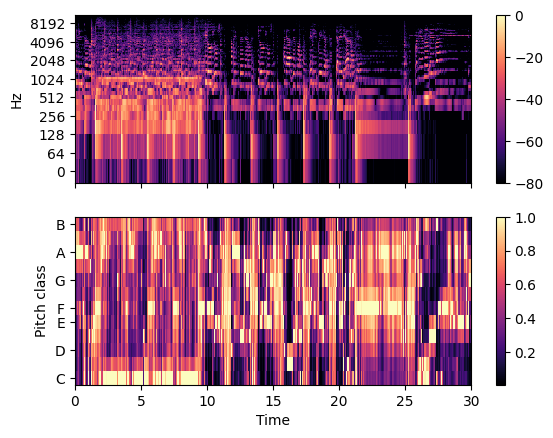

In [243]:
path = '/content/Data/genres_original/rock/rock.00000.wav'
plt.figure(figsize=(14, 5))
x, sr = librosa.load(path)
librosa.display.waveshow(x, sr=sr, color='grey')

plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform')
plt.show()


# Short-time Fourier transform (STFT)
spectro = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))
scaled_spectro = librosa.amplitude_to_db(spectro, ref = np.max)

plt.figure(figsize = (16, 5))
plt.title('Spectrogram')
librosa.display.specshow(scaled_spectro, sr = sr, hop_length = HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.show()
print()


# Mel Spectrogram
trimmed_audio, _ = librosa.effects.trim(x)
D = np.abs(librosa.stft(x, n_fft = NUM_FFT, hop_length = HOP_LENGTH))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize = (16, 5))
img = librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH, x_axis = 'time', y_axis = 'log')
plt.colorbar();
plt.title("Mel Spectrogram")
plt.show()


# Mel-Frequency Cepestral Coefficents
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
plt.figure(figsize = (16, 5))
plt.title("MFCC")
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# Scaled Mel-Frequency Cepestral Coefficents
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
#print('Mean:', mfccs.mean(), '\n')
#print('Var:', mfccs.var())

plt.figure(figsize = (16, 5))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')


# chroma frequencies
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
#print('Chromogram shape:', chromagram.shape)
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

In [244]:
x, sr = librosa.load('/content/Data/genres_original/rock/rock.00000.wav')
ipd.Audio(x, rate=sr)

## Support Vector Machine Model <br> [SVM]

In [135]:
import os
import random
import loader
import librosa
import numpy as np
import soundfile as sf

import sklearn
from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.inspection import DecisionBoundaryDisplay


def get_features(file_path):
    # y is audio input, and sr is the sampling rate (more samples taken)
    y, sr = librosa.load(file_path,duration = 30)

    # mfcc is the spectral characteristics of the audio signal
    mfccs = librosa.feature.mfcc(y = y, sr = sr, n_mfcc = 13)
    # chroma is the pitch
    chroma = librosa.feature.chroma_stft(y = y, sr = sr)
    # measures the center of mass of the frequency content of the audio signal
    spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)
    # width of the frequency
    spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    # measures the frequency below which a certain percentage of the energy of the spectrum is concentrated
    spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

    # stack the feature arrays vertically
    features = np.vstack([mfccs, chroma, spectral_centroid, spectral_bandwidth, spectral_rolloff])
    mean = np.mean(features, axis = 1)
    return mean


def load_data(file_path):
    #gets the genres (labels) from the dataset
    genres = os.listdir(dataset_path)
    data = []
    labels = []

    for genre in genres:
        genre_path = os.path.join(dataset_path, genre)
        for filename in os.listdir(genre_path):
            file_path = os.path.join(genre_path, filename)
            try:
                features = get_features(file_path)
            except:
                continue
        data.append(features)
        labels.append(genre)
    return np.array(data), np.array(labels)


def run_model(model, model_type):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    print(model_type)
    print('Accuracy: ', accuracy_score(y_test, y_pred))
    print('Confusion Matrix: \n', confusion_matrix(y_test, y_pred))
    print('Classification Report: \n', classification_report(y_test, y_pred))
    print('Cross Validation Score: \n', cross_val_score(model, X_train, y_train, cv=5))
    # print('Predicted labels: ', model.predict(X_test))
    # print('Actual labels: ', y_test)

    plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.title('SVM Decision Plot')
    plt.show()






In [37]:
music_data = pd.read_csv(f'/content/Data/features_30_sec.csv')
music_data = music_data.iloc[0:, 1:]
music_data.head()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,3805.839606,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,3550.522098,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,3042.260232,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,2184.745799,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,3579.757627,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


In [11]:
dataset_path = DATASET_PATH
data, labels = load_data(dataset_path)

<ipython-input-7-c9cea8224f18>:3: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path,duration = 30)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


In [136]:
genre_labels = music_data['label']
data = music_data.loc[:, music_data.columns != 'label']
convertor = LabelEncoder()
genre_list = music_data.iloc[:, -1]
genre_encodings = convertor.fit_transform(genre_list)

# Normalizing
cols = data.columns
min_max_scaler = preprocessing.MinMaxScaler()
np_scaled = min_max_scaler.fit_transform(data)

normalized_data = pd.DataFrame(np_scaled, columns=cols)
normalized_data.head()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,0.113487,0.362279,0.695468,0.318188,0.101983,0.314117,0.040233,0.422879,0.109789,0.385532,...,0.564186,0.112704,0.541287,0.057615,0.422444,0.082450,0.487950,0.109503,0.599189,0.078255
1,0.113487,0.343622,0.793392,0.230894,0.085580,0.248405,0.121475,0.436889,0.296867,0.353329,...,0.570198,0.120353,0.574685,0.118286,0.448184,0.102997,0.548800,0.099081,0.579640,0.075947
2,0.113487,0.389832,0.640692,0.433652,0.099064,0.254261,0.049046,0.325334,0.095712,0.289224,...,0.622467,0.081898,0.331003,0.085962,0.370988,0.116420,0.453724,0.087317,0.501381,0.045405
3,0.113487,0.473508,0.777954,0.345856,0.229160,0.129376,0.058253,0.267404,0.227566,0.181068,...,0.565151,0.091876,0.484549,0.092509,0.460684,0.068975,0.538690,0.062612,0.468060,0.048168
4,0.113487,0.277759,0.681062,0.219641,0.083075,0.327270,0.110761,0.325514,0.113536,0.357017,...,0.383289,0.200462,0.410225,0.156424,0.403875,0.120300,0.424652,0.130173,0.233047,0.094836


In [137]:
fit = StandardScaler()
normed_data = fit.fit_transform(np.array(data.iloc[:, :-1], dtype = float))
X_train, X_test, y_train, y_test = train_test_split(normed_data, genre_encodings, test_size=0.3)

##### [Sklearn.SVC](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC)

SVM: Default
Accuracy:  0.6966666666666667
Confusion Matrix: 
 [[22  0  2  0  0  0  4  0  0  2]
 [ 0 24  0  0  2  2  0  0  0  0]
 [ 0  0 23  1  0  4  0  1  0  3]
 [ 1  0  0 20  5  1  1  0  0  6]
 [ 0  0  0  4 15  0  0  1  4  0]
 [ 2  2  1  0  0 22  0  1  0  0]
 [ 0  0  0  3  0  0 25  0  1  5]
 [ 1  0  2  1  0  0  0 19  1  0]
 [ 1  0  2  0  1  0  0  2 23  0]
 [ 0  0  1  9  0  5  3  1  2 16]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.81      0.73      0.77        30
           1       0.92      0.86      0.89        28
           2       0.74      0.72      0.73        32
           3       0.53      0.59      0.56        34
           4       0.65      0.62      0.64        24
           5       0.65      0.79      0.71        28
           6       0.76      0.74      0.75        34
           7       0.76      0.79      0.78        24
           8       0.74      0.79      0.77        29
           9       0.50      0.43      0

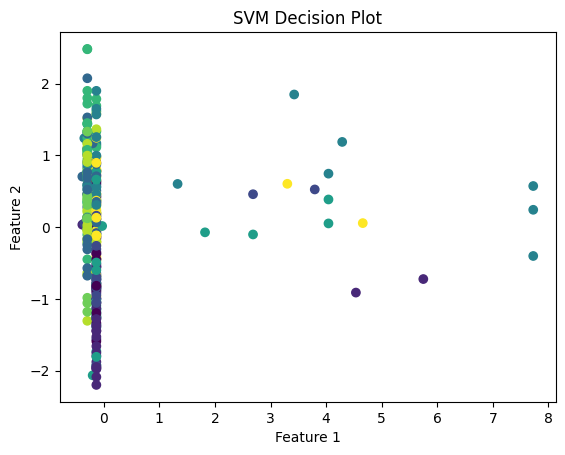

In [138]:
from sklearn import svm
from sklearn.inspection import DecisionBoundaryDisplay
X_train, X_test, y_train, y_test = train_test_split(normed_data, genre_encodings, test_size=0.3, random_state=random.randint(1,100))
svm = svm.SVC()
run_model(svm,"SVM: Default")

##### One-versus-one

SVM: One-versus-One Linear
Accuracy:  0.6733333333333333
Confusion Matrix: 
 [[20  0  5  0  1  1  2  0  0  1]
 [ 0 25  0  0  0  3  0  0  0  0]
 [ 1  2 21  2  1  2  0  0  1  2]
 [ 0  0  1 19  3  0  0  2  3  6]
 [ 0  0  0  3 18  0  0  1  2  0]
 [ 3  1  1  1  0 22  0  0  0  0]
 [ 2  0  2  4  2  0 21  1  0  2]
 [ 0  0  2  1  1  0  0 19  1  0]
 [ 1  0  2  3  3  0  0  0 20  0]
 [ 2  1  3  7  0  1  1  1  4 17]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.69      0.67      0.68        30
           1       0.86      0.89      0.88        28
           2       0.57      0.66      0.61        32
           3       0.47      0.56      0.51        34
           4       0.62      0.75      0.68        24
           5       0.76      0.79      0.77        28
           6       0.88      0.62      0.72        34
           7       0.79      0.79      0.79        24
           8       0.65      0.69      0.67        29
           9       0.61   

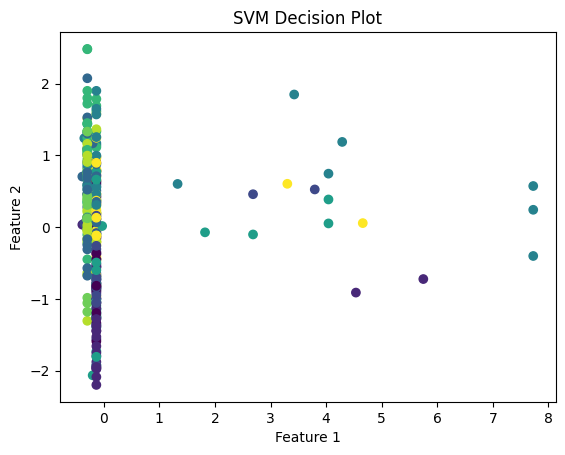

-----------------------------------

SVM: One-versus-One Sigmoid
Accuracy:  0.5766666666666667
Confusion Matrix: 
 [[14  0  3  0  0  1  9  0  0  3]
 [ 0 24  2  0  0  1  0  0  1  0]
 [ 9  0 15  1  1  2  0  1  0  3]
 [ 1  0  1 12  5  1  3  4  0  7]
 [ 1  0  0  3 14  0  0  2  4  0]
 [ 5  1  2  0  1 18  0  0  0  1]
 [ 2  0  0  3  0  0 27  0  0  2]
 [ 1  0  0  1  1  0  0 20  1  0]
 [ 2  0  2  0  3  0  0  4 17  1]
 [ 4  0  3  8  0  2  5  2  1 12]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.36      0.47      0.41        30
           1       0.96      0.86      0.91        28
           2       0.54      0.47      0.50        32
           3       0.43      0.35      0.39        34
           4       0.56      0.58      0.57        24
           5       0.72      0.64      0.68        28
           6       0.61      0.79      0.69        34
           7       0.61      0.83      0.70        24
           8       0.71      0.59      0.6

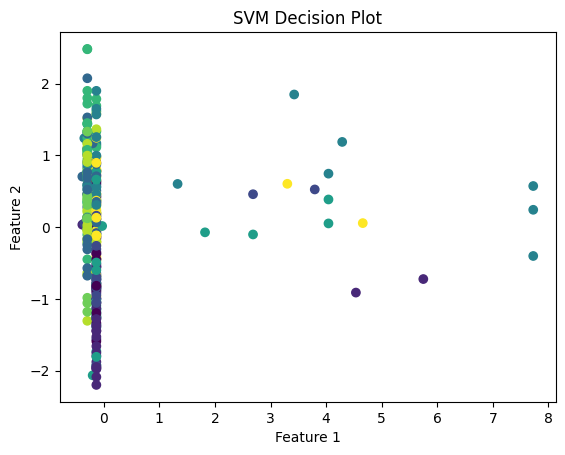

-----------------------------------

SVM: One-versus-One Polynomial
Accuracy:  0.5666666666666667
Confusion Matrix: 
 [[14  0 10  0  0  0  1  0  0  5]
 [ 0 24  1  0  0  3  0  0  0  0]
 [ 0  0 27  1  0  1  0  0  1  2]
 [ 0  0  8 20  1  0  1  0  0  4]
 [ 0  0  3  8 10  0  0  0  3  0]
 [ 1  1  7  2  0 16  0  0  0  1]
 [ 0  0  2  4  0  0 21  0  0  7]
 [ 0  0  6  2  1  0  0 14  1  0]
 [ 0  0 11  0  2  0  0  1 15  0]
 [ 0  0 17  7  0  2  2  0  0  9]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.93      0.47      0.62        30
           1       0.96      0.86      0.91        28
           2       0.29      0.84      0.44        32
           3       0.45      0.59      0.51        34
           4       0.71      0.42      0.53        24
           5       0.73      0.57      0.64        28
           6       0.84      0.62      0.71        34
           7       0.93      0.58      0.72        24
           8       0.75      0.52      

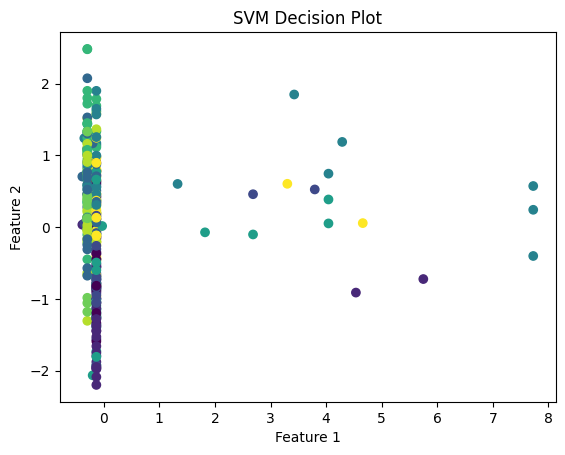

-----------------------------------

SVM: One-versus-One Radial Basis Function
Accuracy:  0.6966666666666667
Confusion Matrix: 
 [[22  0  2  0  0  0  4  0  0  2]
 [ 0 24  0  0  2  2  0  0  0  0]
 [ 0  0 23  1  0  4  0  1  0  3]
 [ 1  0  0 20  5  1  1  0  0  6]
 [ 0  0  0  4 15  0  0  1  4  0]
 [ 2  2  1  0  0 22  0  1  0  0]
 [ 0  0  0  3  0  0 25  0  1  5]
 [ 1  0  2  1  0  0  0 19  1  0]
 [ 1  0  2  0  1  0  0  2 23  0]
 [ 0  0  1  9  0  5  3  1  2 16]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.81      0.73      0.77        30
           1       0.92      0.86      0.89        28
           2       0.74      0.72      0.73        32
           3       0.53      0.59      0.56        34
           4       0.65      0.62      0.64        24
           5       0.65      0.79      0.71        28
           6       0.76      0.74      0.75        34
           7       0.76      0.79      0.78        24
           8       0.74     

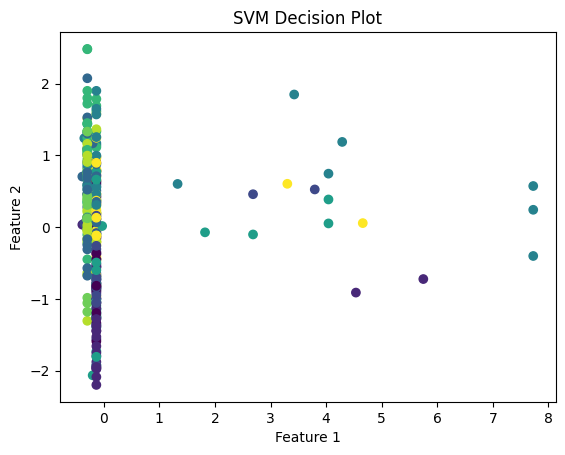

In [139]:
from sklearn import svm
svm_ovo = svm.SVC(decision_function_shape='ovo', kernel='linear')
run_model(svm_ovo, "SVM: One-versus-One Linear")

print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovo', kernel='sigmoid')
run_model(svm_ovo, "SVM: One-versus-One Sigmoid")


print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovo', kernel='poly')
run_model(svm_ovo, "SVM: One-versus-One Polynomial")

print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovo', kernel='rbf')
run_model(svm_ovo, "SVM: One-versus-One Radial Basis Function")


SVM: One-versus-One
Accuracy:  0.5766666666666667
Confusion Matrix: 
 [[12  0  4  1  0  4  1  0  0  4]
 [ 1 22  3  0  0  3  0  0  0  0]
 [ 7  1  9  2  0  2  0  2  0  5]
 [ 2  0  0  9  2  0  6  1  1  4]
 [ 1  0  1  4 17  0  2  3  7  0]
 [ 2  2  1  1  0 24  0  0  0  0]
 [ 1  0  2  0  1  0 30  0  0  2]
 [ 0  0  1  6  2  0  0 20  1  1]
 [ 3  0  1  2  3  0  1  2 19  1]
 [ 6  0  1  5  1  1  1  1  1 11]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.34      0.46      0.39        26
           1       0.88      0.76      0.81        29
           2       0.39      0.32      0.35        28
           3       0.30      0.36      0.33        25
           4       0.65      0.49      0.56        35
           5       0.71      0.80      0.75        30
           6       0.73      0.83      0.78        36
           7       0.69      0.65      0.67        31
           8       0.66      0.59      0.62        32
           9       0.39      0.39

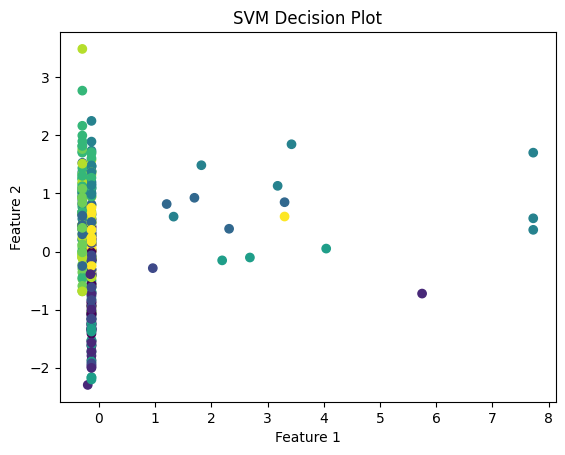

In [141]:
from sklearn import svm
X_train, X_test, y_train, y_test = train_test_split(normed_data, genre_encodings, test_size=0.3, random_state=random.randint(1,100))
svm_ovo = svm.SVC(decision_function_shape='ovo', kernel='sigmoid')
run_model(svm_ovo, "SVM: One-versus-One")

##### One-versus-Rest

SVM: One-versus-One Linear
Accuracy:  0.6733333333333333
Confusion Matrix: 
 [[20  0  5  0  1  1  2  0  0  1]
 [ 0 25  0  0  0  3  0  0  0  0]
 [ 1  2 21  2  1  2  0  0  1  2]
 [ 0  0  1 19  3  0  0  2  3  6]
 [ 0  0  0  3 18  0  0  1  2  0]
 [ 3  1  1  1  0 22  0  0  0  0]
 [ 2  0  2  4  2  0 21  1  0  2]
 [ 0  0  2  1  1  0  0 19  1  0]
 [ 1  0  2  3  3  0  0  0 20  0]
 [ 2  1  3  7  0  1  1  1  4 17]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.69      0.67      0.68        30
           1       0.86      0.89      0.88        28
           2       0.57      0.66      0.61        32
           3       0.47      0.56      0.51        34
           4       0.62      0.75      0.68        24
           5       0.76      0.79      0.77        28
           6       0.88      0.62      0.72        34
           7       0.79      0.79      0.79        24
           8       0.65      0.69      0.67        29
           9       0.61   

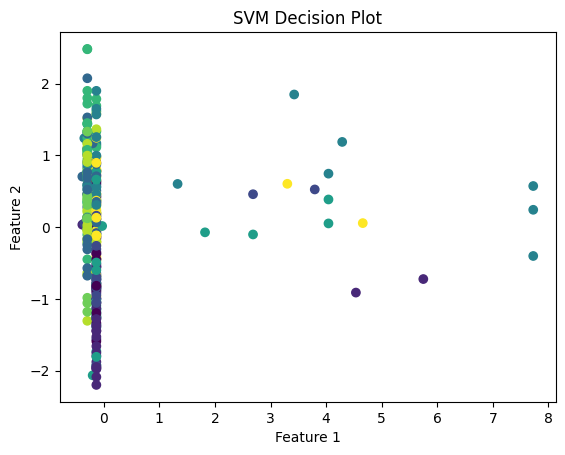

-----------------------------------

SVM: One-versus-One Sigmoid
Accuracy:  0.5766666666666667
Confusion Matrix: 
 [[14  0  3  0  0  1  9  0  0  3]
 [ 0 24  2  0  0  1  0  0  1  0]
 [ 9  0 15  1  1  2  0  1  0  3]
 [ 1  0  1 12  5  1  3  4  0  7]
 [ 1  0  0  3 14  0  0  2  4  0]
 [ 5  1  2  0  1 18  0  0  0  1]
 [ 2  0  0  3  0  0 27  0  0  2]
 [ 1  0  0  1  1  0  0 20  1  0]
 [ 2  0  2  0  3  0  0  4 17  1]
 [ 4  0  3  8  0  2  5  2  1 12]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.36      0.47      0.41        30
           1       0.96      0.86      0.91        28
           2       0.54      0.47      0.50        32
           3       0.43      0.35      0.39        34
           4       0.56      0.58      0.57        24
           5       0.72      0.64      0.68        28
           6       0.61      0.79      0.69        34
           7       0.61      0.83      0.70        24
           8       0.71      0.59      0.6

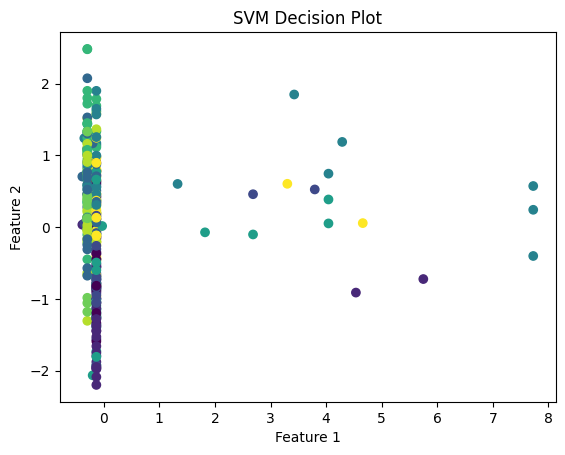

-----------------------------------

SVM: One-versus-One Polynomial
Accuracy:  0.5666666666666667
Confusion Matrix: 
 [[14  0 10  0  0  0  1  0  0  5]
 [ 0 24  1  0  0  3  0  0  0  0]
 [ 0  0 27  1  0  1  0  0  1  2]
 [ 0  0  8 20  1  0  1  0  0  4]
 [ 0  0  3  8 10  0  0  0  3  0]
 [ 1  1  7  2  0 16  0  0  0  1]
 [ 0  0  2  4  0  0 21  0  0  7]
 [ 0  0  6  2  1  0  0 14  1  0]
 [ 0  0 11  0  2  0  0  1 15  0]
 [ 0  0 17  7  0  2  2  0  0  9]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.93      0.47      0.62        30
           1       0.96      0.86      0.91        28
           2       0.29      0.84      0.44        32
           3       0.45      0.59      0.51        34
           4       0.71      0.42      0.53        24
           5       0.73      0.57      0.64        28
           6       0.84      0.62      0.71        34
           7       0.93      0.58      0.72        24
           8       0.75      0.52      

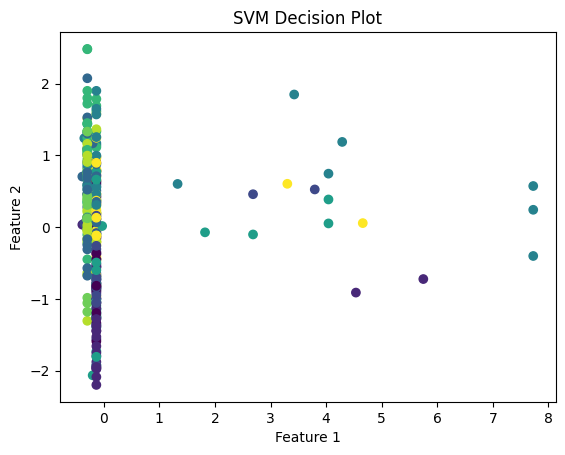

-----------------------------------

SVM: One-versus-One Radial Basis Function
Accuracy:  0.6966666666666667
Confusion Matrix: 
 [[22  0  2  0  0  0  4  0  0  2]
 [ 0 24  0  0  2  2  0  0  0  0]
 [ 0  0 23  1  0  4  0  1  0  3]
 [ 1  0  0 20  5  1  1  0  0  6]
 [ 0  0  0  4 15  0  0  1  4  0]
 [ 2  2  1  0  0 22  0  1  0  0]
 [ 0  0  0  3  0  0 25  0  1  5]
 [ 1  0  2  1  0  0  0 19  1  0]
 [ 1  0  2  0  1  0  0  2 23  0]
 [ 0  0  1  9  0  5  3  1  2 16]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.81      0.73      0.77        30
           1       0.92      0.86      0.89        28
           2       0.74      0.72      0.73        32
           3       0.53      0.59      0.56        34
           4       0.65      0.62      0.64        24
           5       0.65      0.79      0.71        28
           6       0.76      0.74      0.75        34
           7       0.76      0.79      0.78        24
           8       0.74     

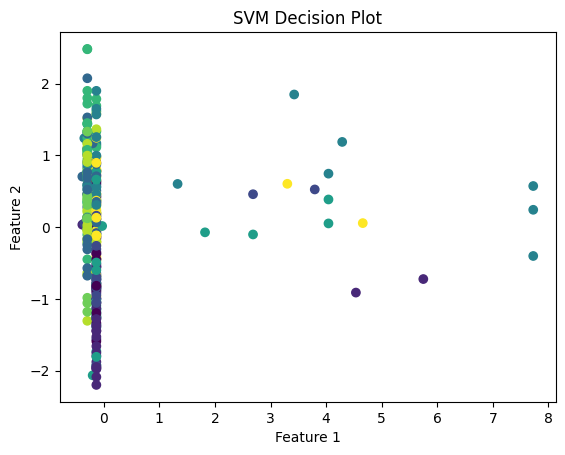

In [140]:
from sklearn import svm
X_train, X_test, y_train, y_test = train_test_split(normed_data, genre_encodings, test_size=0.3, random_state=random.randint(1,100))
svm_ovo = svm.SVC(decision_function_shape='ovr', kernel='linear')
run_model(svm_ovo, "SVM: One-versus-One Linear")

print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovr', kernel='sigmoid')
run_model(svm_ovo, "SVM: One-versus-One Sigmoid")


print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovr', kernel='poly')
run_model(svm_ovo, "SVM: One-versus-One Polynomial")

print("-----------------------------------\n")

svm_ovo = svm.SVC(decision_function_shape='ovr', kernel='rbf')
run_model(svm_ovo, "SVM: One-versus-One Radial Basis Function")


##### [LinearSVC](https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html#sklearn.svm.LinearSVC)

LinearSVC: Default
Accuracy:  0.735
Confusion Matrix: 
 [[16  0  2  2  0  0  2  0  1  2]
 [ 0 24  1  0  0  0  0  0  0  0]
 [ 1  0 11  2  0  0  0  0  0  1]
 [ 1  0  2 11  0  0  1  0  1  1]
 [ 0  0  0  2 15  0  0  2  3  0]
 [ 0  1  1  0  0 13  0  0  0  1]
 [ 0  0  0  0  0  0 14  0  1  0]
 [ 0  1  0  0  0  0  0 20  2  0]
 [ 0  0  2  2  1  0  1  1 10  0]
 [ 0  0  2  2  1  2  2  1  2 13]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.89      0.64      0.74        25
           1       0.92      0.96      0.94        25
           2       0.52      0.73      0.61        15
           3       0.52      0.65      0.58        17
           4       0.88      0.68      0.77        22
           5       0.87      0.81      0.84        16
           6       0.70      0.93      0.80        15
           7       0.83      0.87      0.85        23
           8       0.50      0.59      0.54        17
           9       0.72      0.52      0.60    

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


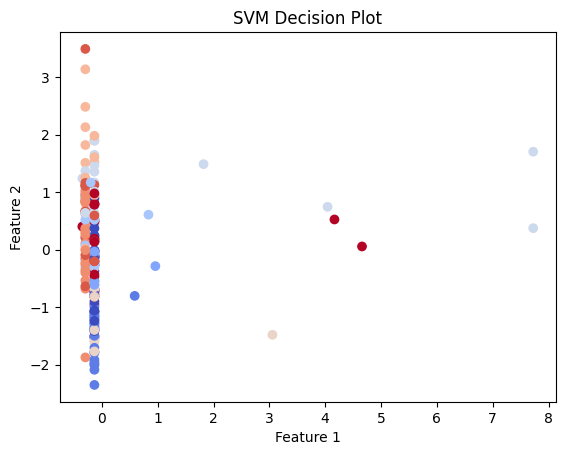

-----------------------------------

LinearSVC: L1 Penalized
Accuracy:  0.755
Confusion Matrix: 
 [[17  0  2  2  0  0  1  0  1  2]
 [ 0 22  1  0  0  2  0  0  0  0]
 [ 1  0 11  1  0  0  0  0  0  2]
 [ 0  0  2 10  0  0  2  0  1  2]
 [ 0  0  0  2 15  0  0  3  2  0]
 [ 0  1  0  0  0 15  0  0  0  0]
 [ 0  0  0  0  0  0 15  0  0  0]
 [ 0  0  0  0  0  0  0 22  1  0]
 [ 0  0  2  1  1  0  0  2 11  0]
 [ 0  0  4  1  1  2  1  1  2 13]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.94      0.68      0.79        25
           1       0.96      0.88      0.92        25
           2       0.50      0.73      0.59        15
           3       0.59      0.59      0.59        17
           4       0.88      0.68      0.77        22
           5       0.79      0.94      0.86        16
           6       0.79      1.00      0.88        15
           7       0.79      0.96      0.86        23
           8       0.61      0.65      0.63        17
     

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


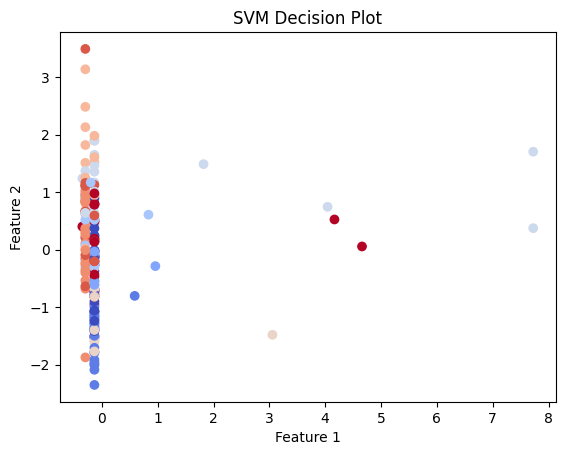

-----------------------------------

LinearSVC: L2 Penalized
Accuracy:  0.735
Confusion Matrix: 
 [[16  0  2  2  0  0  2  0  1  2]
 [ 0 24  1  0  0  0  0  0  0  0]
 [ 1  0 11  2  0  0  0  0  0  1]
 [ 1  0  2 11  0  0  1  0  1  1]
 [ 0  0  0  2 15  0  0  3  2  0]
 [ 0  1  1  0  0 13  0  0  0  1]
 [ 0  0  0  0  0  0 14  0  1  0]
 [ 0  1  0  0  0  0  0 20  2  0]
 [ 0  0  2  1  1  0  1  2 10  0]
 [ 0  0  2  2  1  2  2  1  2 13]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.89      0.64      0.74        25
           1       0.92      0.96      0.94        25
           2       0.52      0.73      0.61        15
           3       0.55      0.65      0.59        17
           4       0.88      0.68      0.77        22
           5       0.87      0.81      0.84        16
           6       0.70      0.93      0.80        15
           7       0.77      0.87      0.82        23
           8       0.53      0.59      0.56        17
     

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


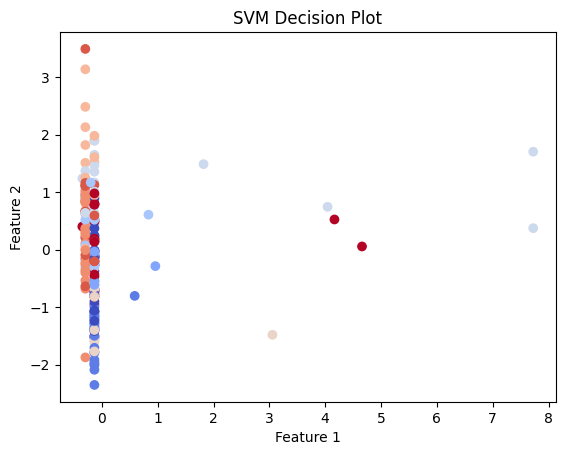

In [117]:
from sklearn.svm import LinearSVC
from sklearn.pipeline import make_pipeline

X_train, X_test, y_train, y_test = train_test_split(normed_data, genre_encodings, test_size=0.3, random_state=random.randint(1,100))
linearSVC = make_pipeline(StandardScaler(), LinearSVC())
run_model(linearSVC,"LinearSVC: Default")

print("-----------------------------------\n")

linearSVC = make_pipeline(StandardScaler(), LinearSVC(penalty='l1', tol=1e-5, loss = 'squared_hinge', dual=False))
run_model(linearSVC,"LinearSVC: L1 Penalized")

print("-----------------------------------\n")

linearSVC = make_pipeline(StandardScaler(), LinearSVC(penalty='l2', tol=1e-5 ))
run_model(linearSVC,"LinearSVC: L2 Penalized")



##### NuSVC

nuSVC
Accuracy:  0.7166666666666667
Confusion Matrix: 
 [[24  0  0  1  0  1  0  0  0  0]
 [ 0 26  0  0  1  2  0  0  0  0]
 [ 1  0 16  3  0  2  0  1  1  4]
 [ 2  0  0 17  0  0  3  0  2  1]
 [ 1  0  0  1 23  0  4  1  5  0]
 [ 0  1  2  2  0 25  0  0  0  0]
 [ 1  0  0  2  1  0 27  0  0  5]
 [ 0  0  1  2  1  0  0 26  0  1]
 [ 2  0  2  1  4  0  1  2 19  1]
 [ 4  0  2  8  0  0  1  0  1 12]]
Classification Report: 
               precision    recall  f1-score   support

           0       0.69      0.92      0.79        26
           1       0.96      0.90      0.93        29
           2       0.70      0.57      0.63        28
           3       0.46      0.68      0.55        25
           4       0.77      0.66      0.71        35
           5       0.83      0.83      0.83        30
           6       0.75      0.75      0.75        36
           7       0.87      0.84      0.85        31
           8       0.68      0.59      0.63        32
           9       0.50      0.43      0.46    

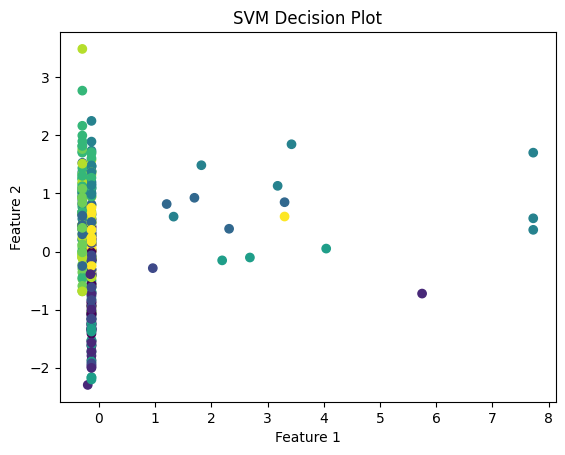

-----------------------------------



In [142]:
from sklearn.svm import NuSVC
from sklearn.pipeline import make_pipeline

nuSVC = make_pipeline(StandardScaler(), NuSVC())
run_model(nuSVC, "nuSVC")

print("-----------------------------------\n")


Accuracy: 0.5933333333333334
Classification Report:
               precision    recall  f1-score   support

           0       0.33      0.54      0.41        26
           1       0.93      0.90      0.91        29
           2       0.41      0.25      0.31        28
           3       0.30      0.52      0.38        25
           4       0.75      0.60      0.67        35
           5       0.69      0.73      0.71        30
           6       0.70      0.64      0.67        36
           7       0.81      0.84      0.83        31
           8       0.78      0.56      0.65        32
           9       0.38      0.29      0.33        28

    accuracy                           0.59       300
   macro avg       0.61      0.59      0.59       300
weighted avg       0.62      0.59      0.60       300

Confusion Matrix: 
 [[14  0  5  1  1  3  1  0  0  1]
 [ 0 26  0  0  0  3  0  0  0  0]
 [13  0  7  1  0  2  0  2  0  3]
 [ 2  0  0 13  2  0  5  0  0  3]
 [ 1  0  1  4 21  0  2  2  4  0]
 [ 

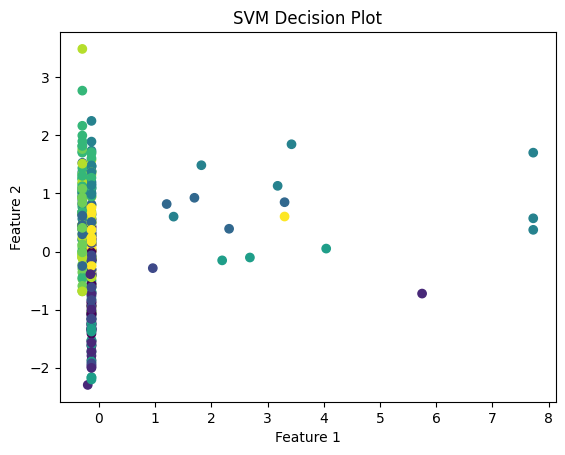

In [145]:
# SVM with PCA
pca = PCA(n_components=10)
pca.fit(X_train)
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

svm_pca = svm.SVC(kernel='linear', C=1.0, decision_function_shape='ovr')
svm_pca.fit(X_train_pca, y_train)

y_pred_pca = svm_pca.predict(X_test_pca)

print("Accuracy:", accuracy_score(y_test, y_pred_pca))
print("Classification Report:\n", classification_report(y_test, y_pred_pca))
print('Confusion Matrix: \n', confusion_matrix(y_test, y_pred_pca))
print('Classification Report: \n', classification_report(y_test, y_pred_pca))
print('Cross Validation Score: \n', cross_val_score(svm_pca, X_train_pca, y_train, cv=5))
# print('Predicted labels: ', model.predict(X_test))
# print('Actual labels: ', y_test)

plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test)
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('SVM Decision Plot')
plt.show()

## K-Nearest Neighbor Model<br>[KNN]

In [ ]:
import os
import librosa
import soundfile as sf
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report

def get_features(file_path):

  #y is audio input, and sr is the sampling rate (more samples taken)
  y, sr = librosa.load(file_path,duration = 30)

  #mfcc is thespectral characteristics of the audio signal
  mfccs = librosa.feature.mfcc(y = y, sr = sr, n_mfcc = 13)
  #chroma is the pitch
  chroma = librosa.feature.chroma_stft(y = y, sr = sr)
  #measures the center of mass of the frequency content of the audio signal
  spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)
  #width of the frequency
  spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  #measures the frequency below which a certain percentage of the energy of the spectrum is concentrated
  spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

  #stack the feature arrays vertically
  features = np.vstack([mfccs, chroma, spectral_centroid, spectral_bandwidth, spectral_rolloff])

  #gets the mean of all values in the stacked arrays
  mean = np.mean(features, axis = 1)

  return mean

#load the gtzan dataset
def load_data(file_path):
  #gets the genres (labels) from the dataset
  genres = os.listdir(dataset_path)
  data = []
  labels = []

  for genre in genres:
    genre_path = os.path.join(dataset_path, genre)
    for filename in os.listdir(genre_path):
      file_path = os.path.join(genre_path, filename)
      try:
        features = get_features(file_path)
      except:
        continue
      data.append(features)
      labels.append(genre)
  return np.array(data), np.array(labels)

#music_data = pd.read_csv('/content/Data/features_30_sec.csv')
#music_data['label'].value_counts()

dataset_path = "/content/Data/genres_original/"

#load and process the data
data, labels = load_data(dataset_path)

#split into training and testing sets                           #20% for testing  #controls the randomization of the shuffling
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

k = 5
knn_classifier = KNeighborsClassifier(n_neighbors=k)
knn_classifier.fit(X_train, y_train)

y_predict = knn_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy: {accuracy:.2f}")

print("Classification Report")
report = classification_report(y_test,y_predict)
print(report)


<ipython-input-24-9cf5408b1c57>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path,duration = 30)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


In [ ]:
import os
import librosa
import soundfile as sf
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report

def get_features(file_path):

  #y is audio input, and sr is the sampling rate (more samples taken)
  y, sr = librosa.load(file_path,duration = 30)

  #mfcc is thespectral characteristics of the audio signal
  mfccs = librosa.feature.mfcc(y = y, sr = sr, n_mfcc = 13)
  #chroma is the pitch
  chroma = librosa.feature.chroma_stft(y = y, sr = sr)
  #measures the center of mass of the frequency content of the audio signal
  spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)
  #width of the frequency
  spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  #measures the frequency below which a certain percentage of the energy of the spectrum is concentrated
  spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

  #stack the feature arrays vertically
  features = np.vstack([mfccs, chroma, spectral_centroid, spectral_bandwidth, spectral_rolloff])

  #gets the mean of all values in the stacked arrays
  mean = np.mean(features, axis = 1)

  return mean

#load the gtzan dataset
def load_data(file_path):
  #gets the genres (labels) from the dataset
  genres = os.listdir(dataset_path)
  data = []
  labels = []

  for genre in genres:
    genre_path = os.path.join(dataset_path, genre)
    for filename in os.listdir(genre_path):
      file_path = os.path.join(genre_path, filename)
      try:
        features = get_features(file_path)
      except:
        continue
      data.append(features)
      labels.append(genre)

  return np.array(data), np.array(labels)

dataset_path = "/content/Data/genres_original/"

#load and process the data
data, labels = load_data(dataset_path)

#split into training and testing sets                           #20% for testing  #controls the randomization of the shuffling
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

k = 4
knn_classifier = KNeighborsClassifier(n_neighbors=k)
knn_classifier.fit(X_train, y_train)

y_predict = knn_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy: {accuracy:.2f}")

print("Classification Report")
report = classification_report(y_test,y_predict)
print(report)


<ipython-input-27-3ac2c5627916>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path,duration = 30)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


Accuracy: 0.30
Classification Report
              precision    recall  f1-score   support

       blues       0.31      0.44      0.36        27
   classical       0.83      0.86      0.84        22
     country       0.16      0.24      0.19        21
       disco       0.06      0.06      0.06        18
      hiphop       0.14      0.11      0.12        19
        jazz       0.30      0.27      0.29        22
       metal       0.62      0.33      0.43        24
         pop       0.29      0.33      0.31        15
      reggae       0.12      0.17      0.14        12
        rock       0.11      0.05      0.07        20

    accuracy                           0.30       200
   macro avg       0.29      0.29      0.28       200
weighted avg       0.32      0.30      0.30       200



In [ ]:
import os
import librosa
import soundfile as sf
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report

def get_features(file_path):

  #y is audio input, and sr is the sampling rate (more samples taken)
  y, sr = librosa.load(file_path,duration = 30)

  #mfcc is thespectral characteristics of the audio signal
  mfccs = librosa.feature.mfcc(y = y, sr = sr, n_mfcc = 13)
  #chroma is the pitch
  chroma = librosa.feature.chroma_stft(y = y, sr = sr)
  #measures the center of mass of the frequency content of the audio signal
  spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)
  #width of the frequency
  spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  #measures the frequency below which a certain percentage of the energy of the spectrum is concentrated
  spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

  #stack the feature arrays vertically
  features = np.vstack([mfccs, chroma, spectral_centroid, spectral_bandwidth, spectral_rolloff])

  #gets the mean of all values in the stacked arrays
  mean = np.mean(features, axis = 1)

  return mean

#load the gtzan dataset
def load_data(file_path):
  #gets the genres (labels) from the dataset
  genres = os.listdir(dataset_path)
  data = []
  labels = []

  for genre in genres:
    genre_path = os.path.join(dataset_path, genre)
    for filename in os.listdir(genre_path):
      file_path = os.path.join(genre_path, filename)
      try:
        features = get_features(file_path)
      except:
        continue
      data.append(features)
      labels.append(genre)

  return np.array(data), np.array(labels)

dataset_path = "/content/Data/genres_original/"

#load and process the data
data, labels = load_data(dataset_path)

#split into training and testing sets                           #20% for testing  #controls the randomization of the shuffling
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

k = 6
knn_classifier = KNeighborsClassifier(n_neighbors=k)
knn_classifier.fit(X_train, y_train)

y_predict = knn_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy: {accuracy:.2f}")

print("Classification Report")
report = classification_report(y_test,y_predict)
print(report)


<ipython-input-28-2b9b5426c39d>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path,duration = 30)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


Accuracy: 0.34
Classification Report
              precision    recall  f1-score   support

       blues       0.34      0.37      0.36        27
   classical       0.83      0.91      0.87        22
     country       0.27      0.38      0.31        21
       disco       0.12      0.17      0.14        18
      hiphop       0.18      0.16      0.17        19
        jazz       0.32      0.32      0.32        22
       metal       0.58      0.29      0.39        24
         pop       0.41      0.47      0.44        15
      reggae       0.11      0.17      0.13        12
        rock       0.00      0.00      0.00        20

    accuracy                           0.34       200
   macro avg       0.32      0.32      0.31       200
weighted avg       0.34      0.34      0.33       200



In [ ]:
import os
import librosa
import soundfile as sf
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report

def get_features(file_path):

  #y is audio input, and sr is the sampling rate (more samples taken)
  y, sr = librosa.load(file_path,duration = 30)

  #mfcc is thespectral characteristics of the audio signal
  mfccs = librosa.feature.mfcc(y = y, sr = sr, n_mfcc = 13)
  #chroma is the pitch
  chroma = librosa.feature.chroma_stft(y = y, sr = sr)
  #measures the center of mass of the frequency content of the audio signal
  spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)
  #width of the frequency
  spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  #measures the frequency below which a certain percentage of the energy of the spectrum is concentrated
  spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

  #stack the feature arrays vertically
  features = np.vstack([mfccs, chroma, spectral_centroid, spectral_bandwidth, spectral_rolloff])

  #gets the mean of all values in the stacked arrays
  mean = np.mean(features, axis = 1)

  return mean

#load the gtzan dataset
def load_data(file_path):
  #gets the genres (labels) from the dataset
  genres = os.listdir(dataset_path)
  data = []
  labels = []

  for genre in genres:
    genre_path = os.path.join(dataset_path, genre)
    for filename in os.listdir(genre_path):
      file_path = os.path.join(genre_path, filename)
      try:
        features = get_features(file_path)
      except:
        continue
      data.append(features)
      labels.append(genre)

  return np.array(data), np.array(labels)

dataset_path = "/content/Data/genres_original/"

#load and process the data
data, labels = load_data(dataset_path)

#split into training and testing sets                           #20% for testing  #controls the randomization of the shuffling
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

k = 10
knn_classifier = KNeighborsClassifier(n_neighbors=k)
knn_classifier.fit(X_train, y_train)

y_predict = knn_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy: {accuracy:.2f}")

print("Classification Report")
report = classification_report(y_test,y_predict)
print(report)


<ipython-input-29-d48302ebe8e6>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path,duration = 30)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


Accuracy: 0.30
Classification Report
              precision    recall  f1-score   support

       blues       0.40      0.37      0.38        27
   classical       0.61      0.91      0.73        22
     country       0.17      0.19      0.18        21
       disco       0.00      0.00      0.00        18
      hiphop       0.16      0.16      0.16        19
        jazz       0.27      0.18      0.22        22
       metal       0.46      0.25      0.32        24
         pop       0.33      0.47      0.39        15
      reggae       0.28      0.42      0.33        12
        rock       0.09      0.05      0.06        20

    accuracy                           0.30       200
   macro avg       0.28      0.30      0.28       200
weighted avg       0.29      0.30      0.28       200



## Convolutional Neural Network Model<br>[CNN]

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, datasets
import torchaudio
#import os
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from keras.models import Sequential
import keras

df=pd.read_csv('/content/Data/features_30_sec.csv')
df=df.drop(labels='filename',axis=1)  # remove filenames column
# Set y as the results
class_list=df.iloc[:,-1]
convertor = LabelEncoder()
y=convertor.fit_transform(class_list)

# Scale features
fit = StandardScaler()
X = fit.fit_transform(np.array(df.iloc[:,:-1],dtype=float)) # sets all types to float, and leaves out the y

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=.33)

def trainModel(model,epochs,optimizer):
  batch=128
  model.compile(optimizer=optimizer,loss='sparse_categorical_crossentropy',
                metrics='accuracy')
  return model.fit(X_train, y_train, validation_data=(X_test,y_test),
                   epochs=epochs,batch_size=batch)

model=keras.models.Sequential([
    keras.layers.Dense(512,activation='relu',input_shape=(X_train.shape[1],)),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(64,activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(10,activation='softmax'),
])
print(model.summary())
model_history=trainModel(model=model, epochs=50, optimizer='adam')

test_loss, test_acc = model.evaluate(X_test, y_test, batch_size=128)
print("Test Loss: ",test_loss)
print("Best test accuracy: ",test_acc)

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_18 (Dense)            (None, 512)               30208     
                                                                 
 dropout_12 (Dropout)        (None, 512)               0         
                                                                 
 dense_19 (Dense)            (None, 64)                32832     
                                                                 
 dropout_13 (Dropout)        (None, 64)                0         
                                                                 
 dense_20 (Dense)            (None, 10)                650       
                                                                 
Total params: 63690 (248.79 KB)
Trainable params: 63690 (248.79 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
None
Epoch 1/50


----

# Concepts:

### Spectral Features Explained



| Feature  | Definiton |
|:--|:--|
| **chroma_stft_mean** |Chroma features capture the pitch content of the audio signal. The mean of the chroma features is used to represent the overall pitch distribution of the audio file.|
| **chroma_stft_var** | The variance of the chroma features captures the variability in the pitch content of the audio file. |
| **rms_mean** | Root-mean-square (RMS) energy is a measure of the overall loudness of the audio signal. The mean of the RMS energy is used to represent the overall loudness of the audio file. |
| **rms_var** | The variance of the RMS energy captures the variability in the loudness of the audio file. |
| **spectral_centroid_mean** | The spectral centroid is a measure of the center of mass of the frequency content of the audio signal. The mean of the spectral centroid is used to represent the overall spectral distribution of the audio file. |
| **spectral_centroid_var** | The variance of the spectral centroid captures the variability in the spectral distribution of the audio file. |
| **Spectral bandwidth** | The spectral bandwidth is a measure of the width of the frequency content of the audio signal.|
|**spectral_bandwidth_mean**| The mean of the spectral bandwidth is used to represent the overall bandwidth of the audio file.|
|**spectral_bandwidth_var**|  The variance of the spectral bandwidth captures the variability in the bandwidth of the audio file. |
|**rolloff**| The spectral rolloff is a measure of the frequency below which a certain percentage (typically 85%) of the energy of the spectrum is concentrated. |
| **rolloff_mean** | The mean of the spectral rolloff is used to represent the overall frequency content of the audio file. |
|**rolloff_var**| **The variance of the spectral rolloff captures the variability in the frequency content of the audio file.** |
|**Harmony**| The harmony features capture the harmonic content of the audio signal. |
| **Harmony_mean** | The mean of the harmony features is used to represent the overall harmonic content of the audio file. |
|**harmony_var**| The variance of the harmony features captures the variability in the harmonic content of the audio file. |
|**Mel-frequency cepstral coefficients (MFCCs)**|  Set of features that capture the spectral characteristics of the audio signal. |
| **mfcc_mean**<br>**mfcc_var** |  The mean and variance of the first 20 MFCCs are used to represent the overall spectral content of the audio file.||
| **Perceptual features** | Capture various psychoacoustic characteristics of the audio signal.  |
| **perceptr_mean** | The mean of the perceptual features is used to represent the overall perceptual characteristics of the audio file. |
|**perceptr_var**| The variance of the perceptual features captures the variability in the perceptual characteristics of the audio file. |
|**Zero_cross_rate**|The zero-crossing rate is a measure of the number of times the audio signal crosses the zero axis per unit of time. |
| **zero_crossing_rate_mean** | The mean of the zero-crossing rate is used to represent the overall temporal characteristics of the audio file |
|**zero_crossing_rate_var:**| The variance of the zero-crossing rate captures the variability in the temporal characteristics of the audio file. |



### Energy
The **energy** of a signal corresponds to the total magntiude of a signal.<br> For audio signals, that roughly corresponds to how loud the signal is. The energy in a signal is defined as:

$$ \sum_n \left| x(n) \right|^2 $$


The **root-mean-square energy (RMSE)** in a signal is defined as

$$ \sqrt{ \frac{1}{N} \sum_n \left| x(n) \right|^2 } $$

In [ ]:
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
print(x.shape)
print(sr)

ipd.Audio(x, rate=sr)
hop_length = 256
frame_length = 512

energy = np.array([
    sum(abs(x[i:i+frame_length]**2))
    for i in range(0, len(x), hop_length)
])

energy.shape

(661794,)
22050


(2586,)

In [ ]:
rsme = np.array([
    np.sqrt(np.mean(x[i:i+frame_length]**2))
    for i in range(0, len(x), hop_length)
])
rmse = librosa.feature.rms(y=x, frame_length=frame_length, hop_length=hop_length)[0]

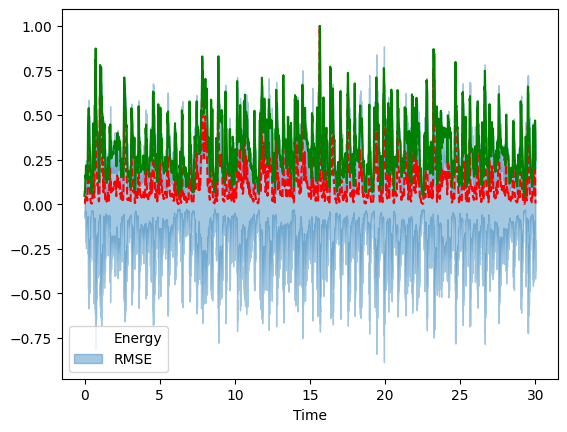

In [ ]:
frames = range(len(energy))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, energy/energy.max(), 'r--')             # normalized for visualization
plt.plot(t[:len(rmse)], rmse/rmse.max(), color='g') # normalized for visualization
plt.legend(('Energy', 'RMSE'))

In [ ]:
## @TODO Need to implement stripping on audio here
def strip(audio, frame_length, hop_length):
  """
  removes leading silence from a signal
  """

  # Return the trimmed signal.
  return None


### Zero Crossing Rate:
The zero crossing rate indicates the number of times that a signal crosses the horizontal axis.




69
(1, 1293)


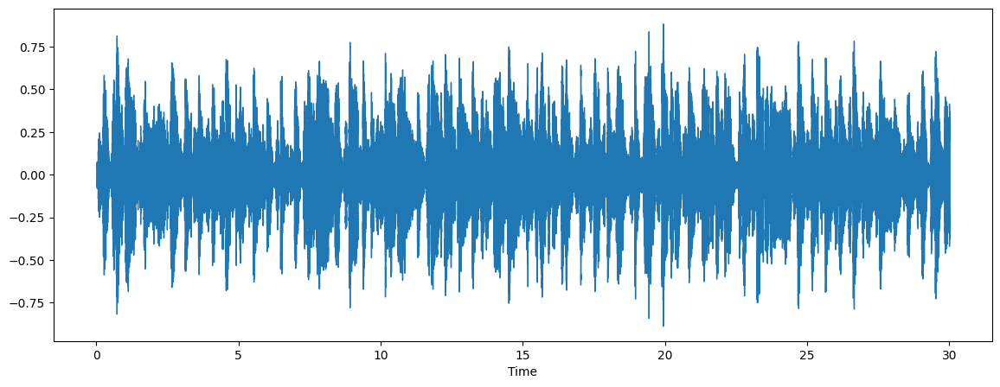

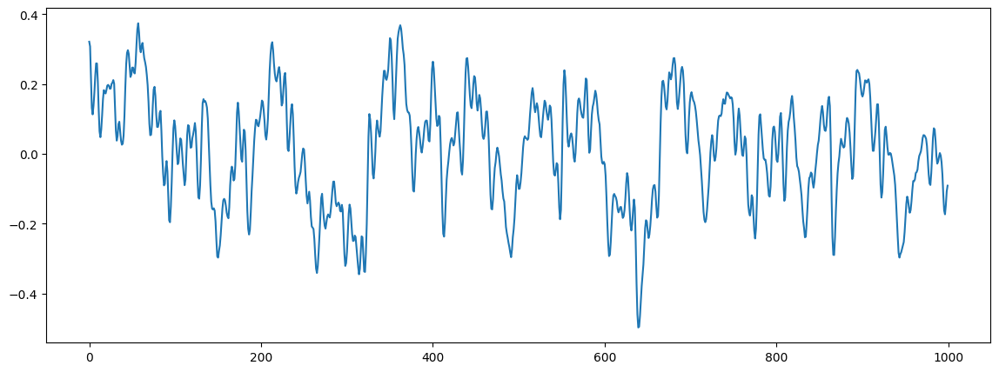

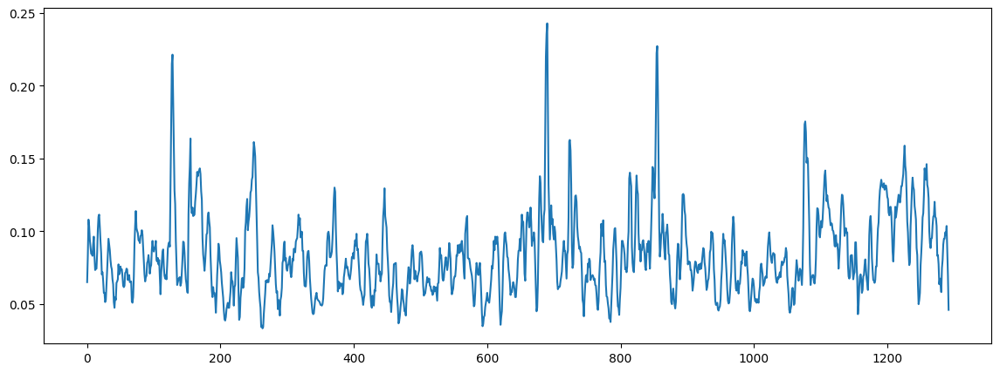

In [202]:
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display

# audio file
# sampling rate
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
ipd.Audio(x, rate=sr)

plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

n0 = 6500
n1 = 7500
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])

zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
zero_crossings.shape
print(sum(zero_crossings))

zcrs = librosa.feature.zero_crossing_rate(x)
print(zcrs.shape)
plt.figure(figsize=(14, 5))
plt.plot(zcrs[0])

### Fournier Transforms


Transforms time-domain signals into the *frequency domain*. Whereas the time domain expresses our signal as a sequence of samples, the frequency domain expresses our signal as a *superposition of sinusoids* of varying magnitudes, frequencies, and phase offsets.<br><br>


<footnote>
  "frequency domain" is a way to show all the different pitches in the song at once, instead of in the order they happen over time. It's like taking a musical chord and instead of hearing it as one sound, you see each individual note laid out in front of you.<br>
  When we talk about the signal as a "superposition of sinusoids," imagine that every sound in your song can be thought of as a bunch of smooth waves (these waves are called "sinusoids") all added together. Some waves are tall and slow and represent lower pitches, and some are short and fast for higher pitches. Each wave has a certain height (which is its "magnitude" or how loud it is), a speed (which is its "frequency" or pitch), and a starting point (which is its "phase offset" or when it starts).
</footnote>

In [ ]:
%matplotlib inline
import seaborn
import numpy, scipy, matplotlib.pyplot as plt, librosa, IPython.display as ipd
from scipy.fftpack import fft, ifft

In [ ]:
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav')
print(x.shape)
print(sr)
ipd.Audio(x, rate=sr)

In [ ]:
X = scipy.fftpack.fft(x)
X_mag = numpy.absolute(X)
f = numpy.linspace(0, sr, len(X_mag)) # frequency variable

plt.figure(figsize=(13, 5))
plt.plot(f, X_mag) # magnitude spectrum
plt.xlabel('Frequency (Hz)')

plt.figure(figsize=(13, 5))
plt.plot(f[:5000], X_mag[:5000])
plt.xlabel('Frequency (Hz)')

### [`mir_eval`](https://craffel.github.io/mir_eval/) Library
The music information retrival library enables analysis on the following:
- onset, tempo, beat
- chord, key
- melody, multipitch
- transcription
- segment, hierarchy, pattern

### Librosa and Spectrograms


In [ ]:
%matplotlib inline
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import sklearn, pandas, seaborn
import librosa, librosa.display

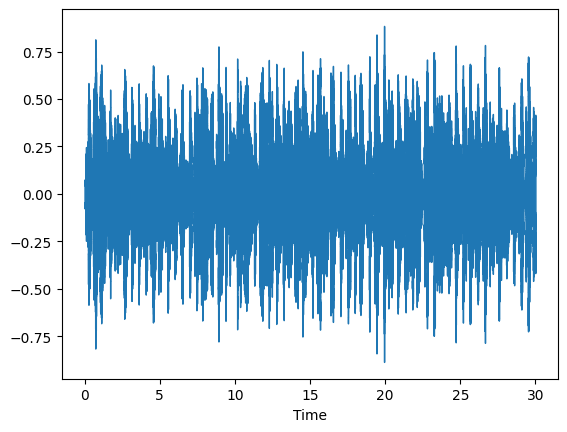

In [ ]:
x, sr = librosa.load('/content/Data/genres_original/blues/blues.00000.wav', duration=30)
librosa.display.waveshow(x, sr=sr)
ipd.Audio(x, rate=sr)

<ipython-input-47-e5ecfee96d88>:2: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  Xmag = librosa.amplitude_to_db(X)


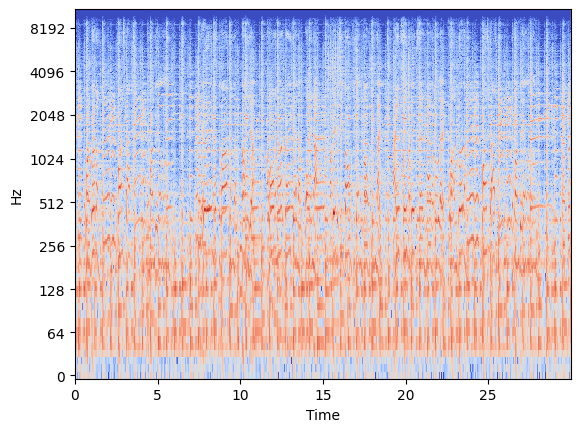

In [ ]:
X = librosa.stft(x)
Xmag = librosa.amplitude_to_db(X)
librosa.display.specshow(Xmag, sr=sr, x_axis='time', y_axis='log')

### [Windowing Functions](https://en.wikipedia.org/wiki/Window_function)<br>
<sub>Also known as an ***apodization function*** or ***tapering function*** </sub>

A mathematical function that is zero-valued outside of some chosen interval, normally symmetric around the middle of the interval, usually approaching a maximum in the middle, and usually tapering away from the middle.

Mathematically, when another function or waveform/data-sequence is "multiplied" by a window function, the product is also zero-valued outside the interval: all that is left is the part where they overlap, the "**view through the window**".

#### Hann Window:
It is a window function used to perform Hann smoothing. The function, with length L and amplitude
$ {\displaystyle L/N} $ given by:

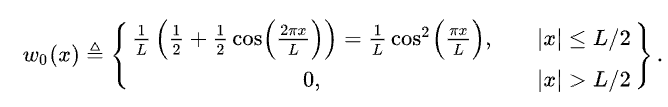

For digital signal processing, the function is sampled symmetrically (with spacing {\displaystyle L/N} and amplitude 1):

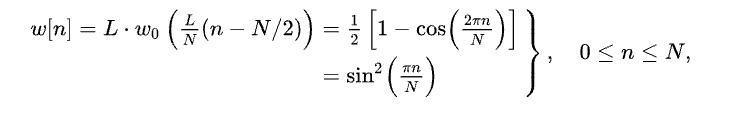

which is a sequence of

*N+1* samples, and *N* can be even or odd.

It is also known as the raised cosine window, Hann filter, von Hann window.


### [Mel&mdash;frequency cepstral coefficents ](https://en.wikipedia.org/wiki/Mel-frequency_cepstrum) (MFCC)

In sound processing, the **mel-frequency cepstrum (MFC)** is a representation of the short-term power spectrum of a sound, based on a linear cosine transform of a log power spectrum on a nonlinear mel scale of frequency.

Mel-frequency cepstral coefficients (MFCCs) are coefficients that collectively make up an MFC

They Take into account how the human ear perceives sound, so they're particularly good at capturing the characteristics of speech and music.

MFCCs break down the sound into different frequency bands and then measure how much energy is in each band.

**MFCCs** are commonly derived as follows:

- Take the Fourier transform of (a windowed excerpt of) a signal.

- Map the powers of the spectrum obtained above onto the mel scale, using triangular overlapping windows or alternatively, cosine overlapping windows.

- Take the logs of the powers at each of the mel frequencies.

- Take the discrete cosine transform of the list of mel log powers, as if it were a signal.

- The MFCCs are the amplitudes of the resulting spectrum.

## Existing Model's Results:

[List of Model Results](https://mtg.github.io/essentia-labs/news/tensorflow/2020/01/16/tensorflow-models-released/) [^4]


[Machine Learning for Music Genre Classification Using Visual Mel Spectrum](https://www.mdpi.com/2227-7390/10/23/4427#:~:text=In%20the%20GTZAN%20dataset%2C%20each,and%2016%2Dbit%20audio%20files.) Research Paper [^3]

[Accuracies and confusion matrices for default models](https://acousticbrainz.org/datasets/accuracy) [^5]




##### [AcousticBrainz](https://acousticbrainz.org/datasets/accuracy) [^5]



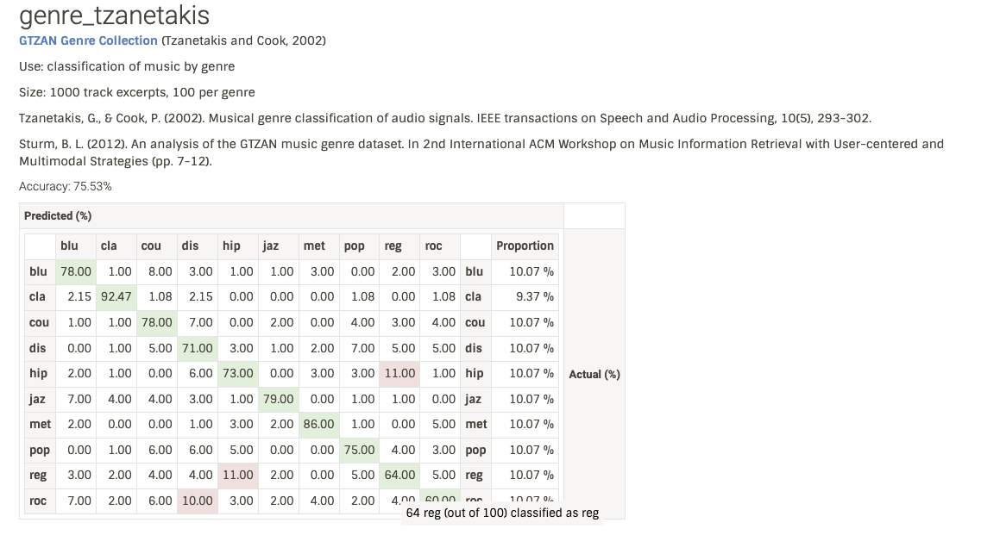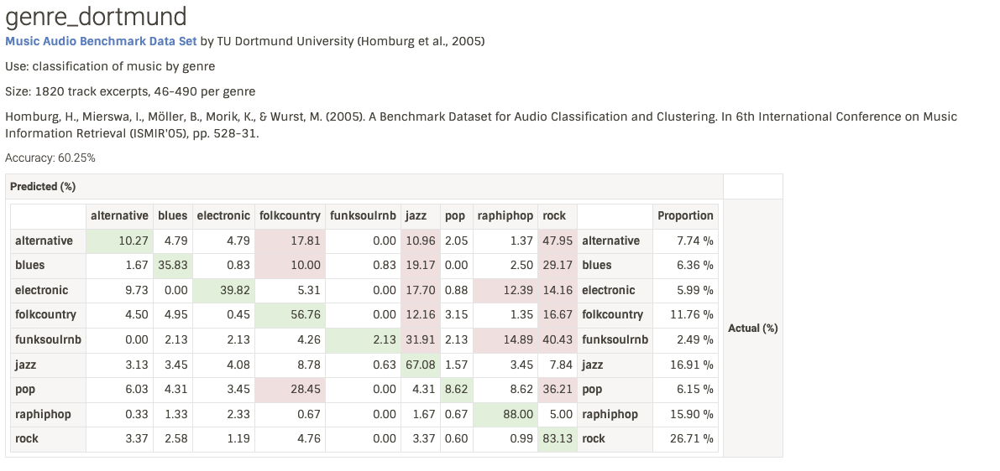

##### [Essentia](https://essentia.upf.edu/models/classifiers/) [^6]

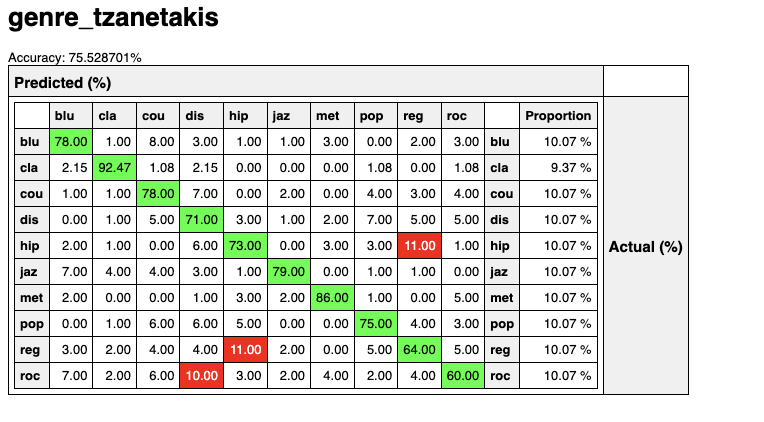

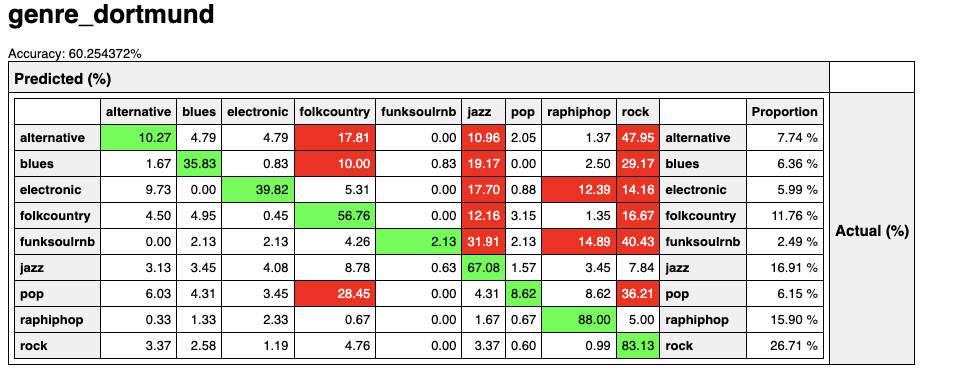

# Citations:



[^1]
Andrada, “GTZAN Dataset - Music Genre Classification,” Kaggle.com, 2020. https://www.kaggle.com/datasets/andradaolteanu/gtzan-dataset-music-genre-classification (accessed Nov. 18, 2023).

[^2]
“TU Dortmund -- Computer Science VIII,” Tu-dortmund.de, 2023. https://www-ai.cs.tu-dortmund.de/audio.html (accessed Nov. 18, 2023).


[^3]:
Y.-H. Cheng and C.-N. Kuo, “Machine Learning for Music Genre Classification Using Visual Mel Spectrum,” Mathematics, vol. 10, no. 23, p. 4427, Nov. 2022, doi: 10.3390/math10234427.

[^4]:
D. Bogdanov, “A collection of TensorFlow models for Essentia,” Essentia Labs, Jan. 16, 2020. https://mtg.github.io/essentia-labs/news/tensorflow/2020/01/16/tensorflow-models-released/ (accessed Nov. 16, 2023).

[^5]:
“AcousticBrainz,” Acousticbrainz.org, 2023. https://acousticbrainz.org/datasets/accuracy (accessed Nov. 16, 2023).

[^6]:
“Index of /models/classifiers/,” Upf.edu, 2023. https://essentia.upf.edu/models/classifiers/ (accessed Nov. 16, 2023).
